Found 720 images from 3 categories.
Feature vector shape: (720, 16)


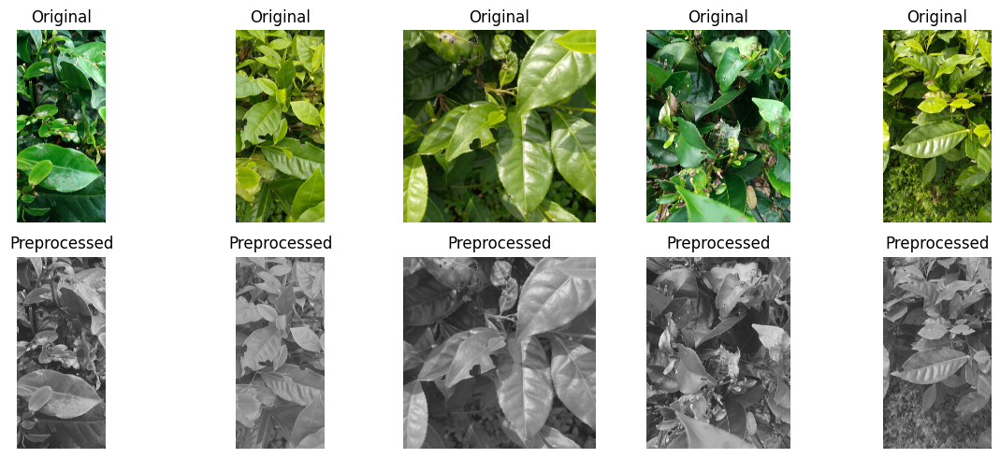

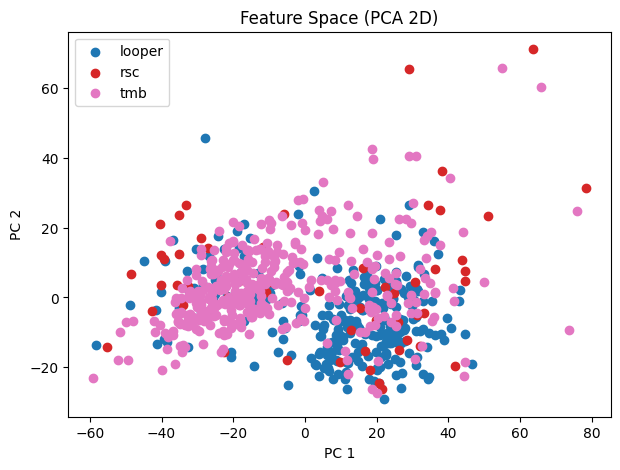

DBSCAN cluster labels: {np.int64(0), np.int64(1), np.int64(2), np.int64(-1)}


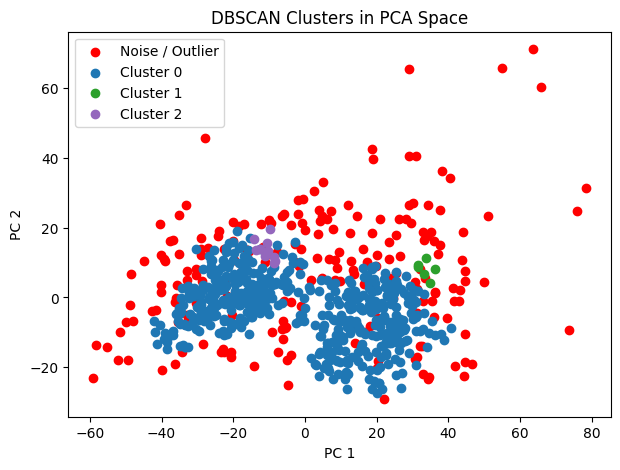

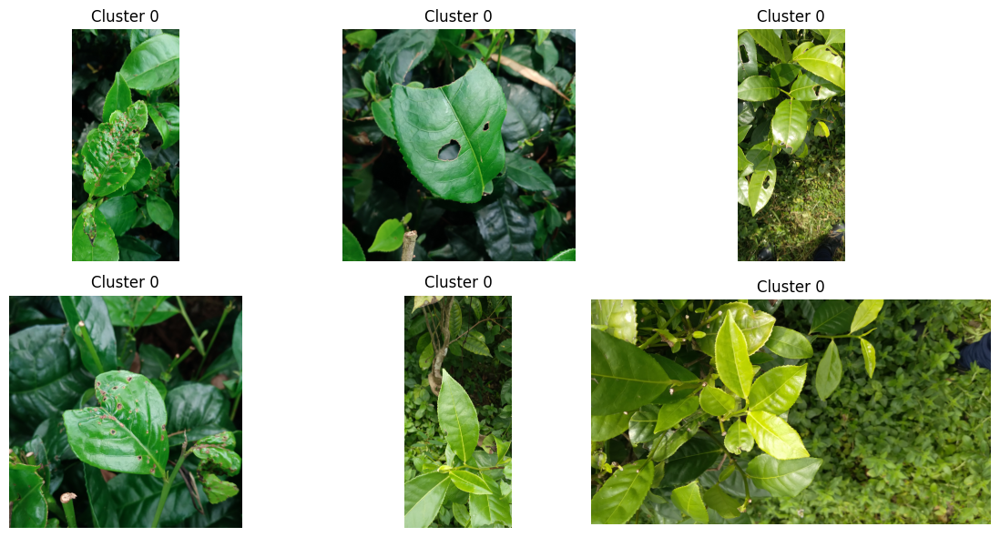

In [ ]:

import os
import glob
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T

from skimage.color import rgb2gray
from skimage.filters import gabor
from skimage.feature import graycomatrix, graycoprops

from skimage.feature import hog  # HOG is still in skimage.feature

from sklearn.decomposition import PCA
from sklearn.cluster import DBSCAN

# -------------------------
# DEVICE SETUP (PyTorch)
# -------------------------
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# -------------------------
# PATH SETUP
# -------------------------
dataset_path = "/home/idrone2/Desktop/sana"   # Replace with your own dataset path
categories = ["looper", "rsc", "tmb"]

# -------------------------
# PREPROCESSING FUNCTION
# -------------------------
def preprocess_image(img_path):
    """
    Loads an image from disk and applies:
      1. Gabor filtering
      2. Normalization
      3. Gaussian blur
    Returns (original_rgb, preprocessed_gray)
    """
    # 1. Load Image
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    
    # 2. Convert to grayscale
    img_gray = rgb2gray(img_rgb)
    
    # 3. Gabor Filtering
    # Frequency can be tuned based on your dataset
    gabor_filtered, _ = gabor(img_gray, frequency=0.6)  
    
    # 4. Normalize to [0, 255]
    gabor_norm = cv2.normalize(gabor_filtered, None, alpha=0, beta=255,
                               norm_type=cv2.NORM_MINMAX).astype(np.uint8)
    
    # 5. Gaussian Blur for noise reduction
    img_blurred = cv2.GaussianBlur(gabor_norm, (5, 5), 0)
    
    return img_rgb, img_blurred

# -------------------------
# FEATURE EXTRACTION
# -------------------------
def extract_features(img_rgb, img_preprocessed_gray):
    features = []
    
    # Convert grayscale image to uint8 (0-255 range)
    img_preprocessed_gray = (img_preprocessed_gray * 255).astype(np.uint8)

    # ---------- (A) Texture Features: GLCM -----------
    glcm = graycomatrix(img_preprocessed_gray, distances=[1], angles=[0],
                        levels=256, symmetric=True, normed=True)
    
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    energy = graycoprops(glcm, 'energy')[0, 0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0, 0]
    features.extend([contrast, energy, homogeneity])

    # ---------- (B) Color Features: Mean RGB ----------
    mean_r = np.mean(img_rgb[:, :, 0])
    mean_g = np.mean(img_rgb[:, :, 1])
    mean_b = np.mean(img_rgb[:, :, 2])
    features.extend([mean_r, mean_g, mean_b])

    # ---------- (C) Shape Features: HOG ---------------
    hog_desc = hog(img_preprocessed_gray,
                   pixels_per_cell=(8, 8),
                   cells_per_block=(2, 2),
                   feature_vector=True)
    features.extend(hog_desc[:10])  # Use first 10 features for simplicity

    return np.array(features)


# -------------------------
# LOAD DATASET
# -------------------------
image_paths = []
labels = []
for category in categories:
    cat_path = os.path.join(dataset_path, category)
    for img_file in glob.glob(os.path.join(cat_path, "*.jpg")):
        image_paths.append(img_file)
        labels.append(category)

print(f"Found {len(image_paths)} images from {len(categories)} categories.")

# -------------------------
# PREPROCESS & EXTRACT FEATURES
# -------------------------
feature_vectors = []
orig_images = []
processed_images = []

for img_path in image_paths:
    # 1. Preprocess
    img_rgb, img_gabor = preprocess_image(img_path)
    # 2. Convert preprocessed image to float gray
    img_gabor_gray = img_gabor.astype(np.float32)
    # 3. Extract features
    feats = extract_features(img_rgb, img_gabor_gray)
    
    feature_vectors.append(feats)
    orig_images.append(img_rgb)
    processed_images.append(img_gabor)

feature_vectors = np.array(feature_vectors)
print("Feature vector shape:", feature_vectors.shape)  # (num_images, num_features)

# -------------------------
# VISUALIZE PREPROCESSING (Side-by-Side)
# -------------------------
def visualize_preprocessing(orig_imgs, proc_imgs, num=5):
    """
    Visualize side-by-side: Original vs. Preprocessed
    for 'num' random images.
    """
    plt.figure(figsize=(12, 5))
    indices = np.random.choice(range(len(orig_imgs)), size=num, replace=False)
    for i, idx in enumerate(indices):
        plt.subplot(2, num, i+1)
        plt.imshow(orig_imgs[idx])
        plt.title("Original")
        plt.axis("off")
        
        plt.subplot(2, num, i+1+num)
        plt.imshow(proc_imgs[idx], cmap="gray")
        plt.title("Preprocessed")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

visualize_preprocessing(orig_images, processed_images, num=5)

# -------------------------
# FEATURE DISTRIBUTION (using PCA for 2D)
# -------------------------
pca = PCA(n_components=2)
pca_feats = pca.fit_transform(feature_vectors)

def visualize_feature_space(pca_feats, labels):
    """
    Scatter plot of the features in 2D PCA space (colored by label).
    """
    # Assign a color per category
    label_unique = list(set(labels))
    color_map = {}
    for i, cat in enumerate(label_unique):
        color_map[cat] = plt.cm.tab10(i / len(label_unique))
    
    plt.figure(figsize=(7, 5))
    for i, label in enumerate(labels):
        plt.scatter(pca_feats[i, 0], pca_feats[i, 1], 
                    color=color_map[label], 
                    label=label if label not in plt.gca().get_legend_handles_labels()[1] else "")
    
    plt.title("Feature Space (PCA 2D)")
    plt.xlabel("PC 1")
    plt.ylabel("PC 2")
    plt.legend()
    plt.show()

visualize_feature_space(pca_feats, labels)

# -------------------------
# DBSCAN CLUSTERING
# -------------------------
dbscan = DBSCAN(eps=5, min_samples=5)
clusters = dbscan.fit_predict(feature_vectors)
print("DBSCAN cluster labels:", set(clusters))

# -------------------------
# VISUALIZE CLUSTERS IN PCA SPACE
# -------------------------
def visualize_clusters_in_pca(pca_feats, cluster_labels):
    """
    Visualize DBSCAN clusters in the PCA-reduced feature space.
    - cluster_labels == -1 usually denotes "noise" points
    """
    unique_clusters = np.unique(cluster_labels)
    plt.figure(figsize=(7, 5))
    
    for cluster_id in unique_clusters:
        # For DBSCAN, -1 is noise/outlier
        if cluster_id == -1:
            color = "red"
            cluster_name = "Noise / Outlier"
        else:
            color = plt.cm.tab10(cluster_id / (len(unique_clusters)+1))
            cluster_name = f"Cluster {cluster_id}"
        
        indices = np.where(cluster_labels == cluster_id)[0]
        plt.scatter(pca_feats[indices, 0],
                    pca_feats[indices, 1],
                    color=color, 
                    label=cluster_name)
    
    plt.title("DBSCAN Clusters in PCA Space")
    plt.xlabel("PC 1")
    plt.ylabel("PC 2")
    plt.legend()
    plt.show()

visualize_clusters_in_pca(pca_feats, clusters)

# -------------------------
# SHOW EXAMPLES WITH CLUSTER LABELS
# -------------------------
def visualize_clustered_images(orig_imgs, cluster_labels, num=6):
    """
    Display some images with their assigned cluster labels.
    """
    # Filter out noise images if needed or just pick random samples
    valid_indices = [i for i in range(len(cluster_labels)) if cluster_labels[i] != -1]
    if len(valid_indices) < num:
        num = len(valid_indices)
    
    plt.figure(figsize=(12, 6))
    chosen_indices = np.random.choice(valid_indices, size=num, replace=False)
    for i, idx in enumerate(chosen_indices):
        plt.subplot(2, num//2, i+1)
        plt.imshow(orig_imgs[idx])
        plt.title(f"Cluster {cluster_labels[idx]}")
        plt.axis("off")
    plt.tight_layout()
    plt.show()

visualize_clustered_images(orig_images, clusters, num=6)


In [3]:
import skimage.feature
print(dir(skimage.feature))


['BRIEF', 'CENSURE', 'Cascade', 'ORB', 'SIFT', 'blob_dog', 'blob_doh', 'blob_log', 'canny', 'corner_fast', 'corner_foerstner', 'corner_harris', 'corner_kitchen_rosenfeld', 'corner_moravec', 'corner_orientations', 'corner_peaks', 'corner_shi_tomasi', 'corner_subpix', 'daisy', 'draw_haar_like_feature', 'draw_multiblock_lbp', 'fisher_vector', 'graycomatrix', 'graycoprops', 'haar_like_feature', 'haar_like_feature_coord', 'hessian_matrix', 'hessian_matrix_det', 'hessian_matrix_eigvals', 'hog', 'learn_gmm', 'local_binary_pattern', 'match_descriptors', 'match_template', 'multiblock_lbp', 'multiscale_basic_features', 'peak_local_max', 'plot_matched_features', 'shape_index', 'structure_tensor', 'structure_tensor_eigenvalues']


Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
Total images loaded: 1200


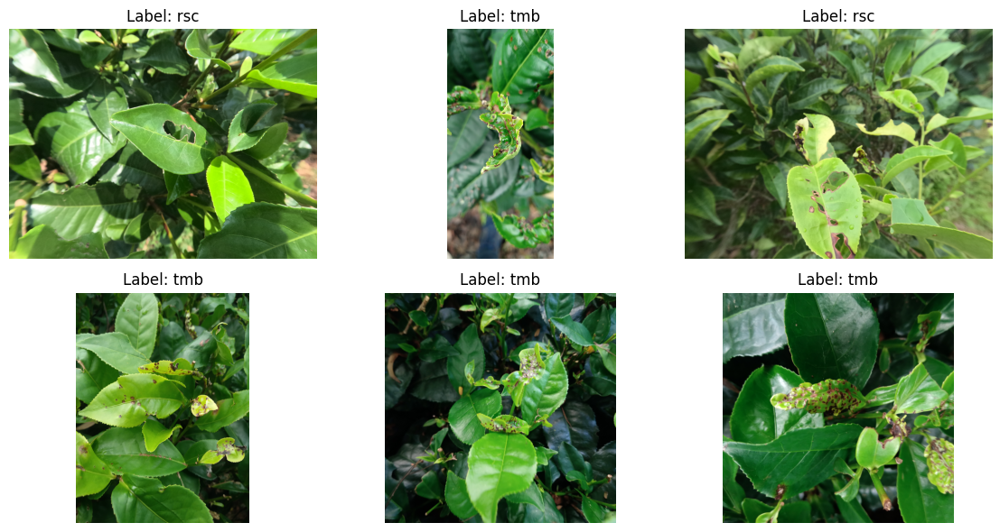

Feature matrix shape: (1200, 96)
Computing pairwise distance matrix (Jeffreys Divergence) ...
Distance matrix shape: (1200, 1200)


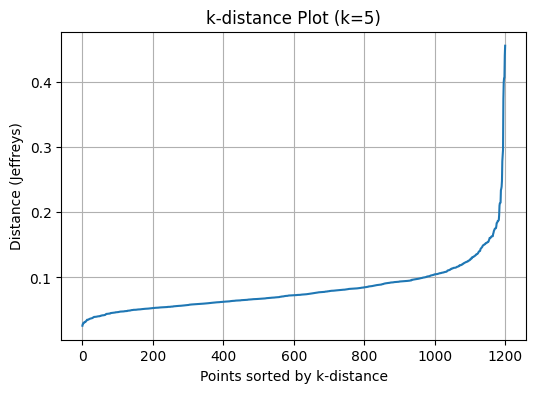

Knee found at index 1164, eps ~ 0.1634
Running DBSCAN with eps=0.1634 ...
Cluster labels found: [-1  0]
Number of clusters (excluding outliers): 1


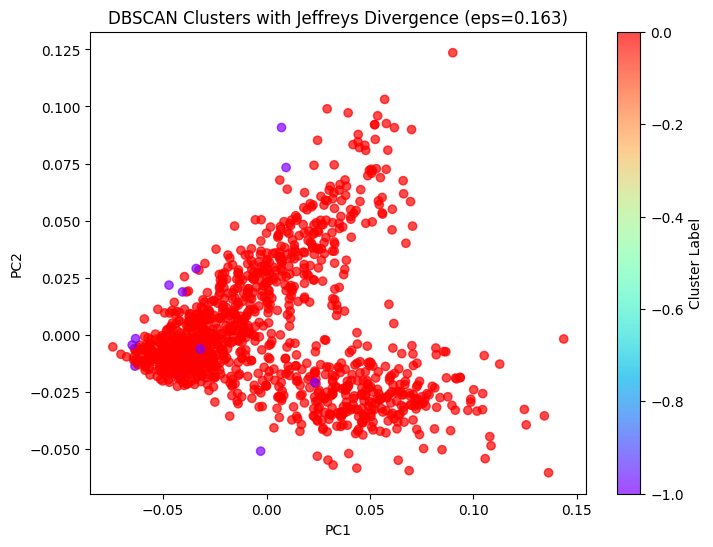

Outlier cluster: 13 points
Cluster 0: 1187 points


In [1]:
%pip install kneed
import os
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Optional: install kneed for elbow detection
# pip install kneed
try:
    from kneed import KneeLocator
    KNEED_AVAILABLE = True
except ImportError:
    KNEED_AVAILABLE = False
    print("Warning: 'kneed' not installed. Will fallback to percentile-based eps.")

from sklearn.cluster import DBSCAN

# ---------------------------------------------------------------- #
#                 1)   LOADING IMAGES                              #
# ---------------------------------------------------------------- #

def load_images_from_folder(folder_path, label_name=None):
    """
    Loads all images in 'folder_path' and returns a list of (image_array, label).
    Some basic error-handling if folder doesn't exist or is empty.
    """
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist.")
        return []
    
    valid_exts = ('.png', '.jpg', '.jpeg', '.bmp')
    image_files = [f for f in os.listdir(folder_path) 
                   if os.path.splitext(f)[1].lower() in valid_exts]
    if len(image_files) == 0:
        print(f"Warning: No valid image files found in '{folder_path}'.")
        return []
    
    data = []
    for fname in image_files:
        fpath = os.path.join(folder_path, fname)
        try:
            img = cv2.imread(fpath)
            if img is None:
                print(f"Warning: Could not read '{fpath}'. Skipping.")
                continue
            # Convert BGR to RGB
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            data.append((img_rgb, label_name))
        except Exception as e:
            print(f"Error reading '{fpath}': {e}")
    return data

# ---------------------------------------------------------------- #
#                 2)   FEATURE EXTRACTION                          #
# ---------------------------------------------------------------- #

def extract_features(img, resize_dim=(128, 128)):
    """
    Example feature extraction:
      1) Resize image
      2) Compute color histogram in R, G, B (32 bins each)
      3) Normalize histogram so sum=1 (probability distribution)
    Returns a 1D numpy array or None if failure.
    """
    try:
        # Resize
        img_resized = cv2.resize(img, resize_dim)
    except Exception as e:
        print(f"Error resizing image: {e}")
        return None
    
    # Convert to float [0, 1]
    img_norm = img_resized.astype(np.float32) / 255.0
    
    # Histograms per channel
    hist_r = cv2.calcHist([img_norm], [0], None, [32], [0,1]).flatten()
    hist_g = cv2.calcHist([img_norm], [1], None, [32], [0,1]).flatten()
    hist_b = cv2.calcHist([img_norm], [2], None, [32], [0,1]).flatten()
    
    # Combine
    feat = np.concatenate((hist_r, hist_g, hist_b))
    
    # Normalize sum to 1
    total = np.sum(feat) + 1e-7
    feat = feat / total
    
    return feat

# ---------------------------------------------------------------- #
#                 3)   JEFFREYS DIVERGENCE                         #
# ---------------------------------------------------------------- #

def jeffreys_divergence(p, q, eps=1e-10):
    """
    Jeffreys Divergence: sum( (p_i - q_i) * log(p_i / q_i) ).
    p, q must be >= 0. 
    We clip to 'eps' to avoid log(0).
    """
    p = np.clip(p, eps, None)
    q = np.clip(q, eps, None)
    return np.sum((p - q) * np.log(p / q))

# ---------------------------------------------------------------- #
#   4)   BUILD PAIRWISE DISTANCE MATRIX (CUSTOM DISTANCE)          #
# ---------------------------------------------------------------- #

def compute_distance_matrix(features):
    """
    Given an array of feature vectors (shape: [N, dim]),
    compute the NxN distance matrix using Jeffreys Divergence.
    
    Returns distance_matrix of shape [N, N].
    """
    n = features.shape[0]
    dist_mat = np.zeros((n, n), dtype=np.float32)
    for i in range(n):
        for j in range(i+1, n):
            dist = jeffreys_divergence(features[i], features[j])
            dist_mat[i, j] = dist
            dist_mat[j, i] = dist
    return dist_mat

# ---------------------------------------------------------------- #
#   5)   AUTO-SELECT EPS BY K-DISTANCE (WITH CUSTOM DISTANCE)      #
# ---------------------------------------------------------------- #

def auto_select_eps_by_k_distance(distance_matrix, min_samples=5, plot=True):
    """
    We do the "k-distance" approach manually on the NxN distance matrix.

    Steps:
     1) For each row i, sort distances to all others. 
        The k-th smallest is the "k-distance" for i.
     2) Sort the k-distances across all samples.
     3) Use an elbow detection or fallback percentile to pick eps.
    """
    n = distance_matrix.shape[0]
    if n < min_samples:
        print("Warning: Not enough points to reliably pick eps. Using default=0.5")
        return 0.5
    
    k = min_samples
    k_distances = []
    
    for i in range(n):
        # distances from point i to others
        drow = distance_matrix[i, :]
        # skip the diagonal (distance to itself = 0) by ignoring i or removing it
        # but strictly we can keep it if we sort. The first "0" is itself.
        # We'll skip index i for clarity:
        dsorted = np.sort(np.delete(drow, i))  # remove self-dist
        # the k-th neighbor -> index (k-1)
        # but ensure we don't go out of bounds if the dataset is small
        if len(dsorted) >= k:
            kth = dsorted[k-1]
        else:
            # fallback if not enough neighbors
            kth = dsorted[-1]
        k_distances.append(kth)
    
    k_distances = np.sort(k_distances)
    
    if plot:
        plt.figure(figsize=(6,4))
        plt.plot(k_distances)
        plt.title(f"k-distance Plot (k={k})")
        plt.xlabel("Points sorted by k-distance")
        plt.ylabel("Distance (Jeffreys)")
        plt.grid(True)
        plt.show()
    
    # Attempt knee detection with kneed
    if KNEED_AVAILABLE:
        try:
            kneedle = KneeLocator(
                x=range(len(k_distances)),
                y=k_distances,
                S=1.0,
                curve='convex',
                direction='increasing'
            )
            knee_idx = kneedle.knee
            knee_val = kneedle.knee_y
            if knee_val is not None:
                print(f"Knee found at index {knee_idx}, eps ~ {knee_val:.4f}")
                return knee_val
            else:
                print("No clear elbow found by kneed. Using fallback percentile (90%).")
        except Exception as e:
            print(f"Exception with KneeLocator: {e}. Using fallback percentile (90%).")
    
    # Fallback approach: pick 90th percentile
    fallback_eps = np.percentile(k_distances, 90)
    print(f"Fallback eps={fallback_eps:.4f} (90th percentile).")
    return fallback_eps

# ---------------------------------------------------------------- #
#                           MAIN PIPELINE                          #
# ---------------------------------------------------------------- #

def main():
    # 1) LOAD THE DATA
    # Adjust for your directory structure
    dataset_path = "/home/idrone2/Desktop/sana"
    subfolders = ["looper", "rsc", "tmb"]
    
    all_data = []
    for sub in subfolders:
        folder_path = os.path.join(dataset_path, sub)
        data = load_images_from_folder(folder_path, label_name=sub)
        all_data.extend(data)
    
    if len(all_data) == 0:
        print("No images loaded. Please check your dataset paths!")
        return
    
    print(f"Total images loaded: {len(all_data)}")
    
    # Display some random samples
    sample_count = min(len(all_data), 6)
    rand_indices = random.sample(range(len(all_data)), sample_count)
    plt.figure(figsize=(12,6))
    for i, idx in enumerate(rand_indices):
        img, label = all_data[idx]
        plt.subplot(2, 3, i+1)
        plt.imshow(img)
        plt.title(f"Label: {label}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    # 2) FEATURE EXTRACTION
    features_list = []
    labels_list = []
    for (img, lbl) in all_data:
        feat = extract_features(img)
        if feat is None:
            continue
        features_list.append(feat)
        labels_list.append(lbl)
    
    if len(features_list) < 2:
        print("Not enough features extracted. Exiting.")
        return
    
    features = np.array(features_list, dtype=np.float32)
    print("Feature matrix shape:", features.shape)
    
    # 3) BUILD PAIRWISE DISTANCE MATRIX WITH JEFFREYS DIVERGENCE
    print("Computing pairwise distance matrix (Jeffreys Divergence) ...")
    dist_matrix = compute_distance_matrix(features)
    print("Distance matrix shape:", dist_matrix.shape)
    
    # 4) AUTO-SELECT EPS FROM K-DISTANCE
    min_samples = 5
    estimated_eps = auto_select_eps_by_k_distance(dist_matrix, 
                                                  min_samples=min_samples, 
                                                  plot=True)
    
    # 5) RUN DBSCAN WITH 'precomputed' METRIC
    print(f"Running DBSCAN with eps={estimated_eps:.4f} ...")
    dbscan_model = DBSCAN(eps=estimated_eps, 
                          min_samples=min_samples, 
                          metric='precomputed')
    cluster_labels = dbscan_model.fit_predict(dist_matrix)
    
    # 6) SHOW RESULTS
    unique_clusters = np.unique(cluster_labels)
    print("Cluster labels found:", unique_clusters)
    num_clusters = len(unique_clusters[unique_clusters >= 0])
    print(f"Number of clusters (excluding outliers): {num_clusters}")
    
    # Optional: visualize clusters in 2D via PCA
    from sklearn.decomposition import PCA
    pca = PCA(n_components=2)
    reduced = pca.fit_transform(features)
    
    plt.figure(figsize=(8,6))
    scatter = plt.scatter(reduced[:,0], reduced[:,1], 
                          c=cluster_labels, cmap='rainbow', alpha=0.7)
    plt.title(f"DBSCAN Clusters with Jeffreys Divergence (eps={estimated_eps:.3f})")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.colorbar(scatter, label="Cluster Label")
    plt.show()
    
    # Print summary of cluster sizes
    for c in unique_clusters:
        indices = np.where(cluster_labels == c)[0]
        size = len(indices)
        if c == -1:
            print(f"Outlier cluster: {size} points")
        else:
            print(f"Cluster {c}: {size} points")


if __name__ == "__main__":
    main()


Total images loaded: 1200


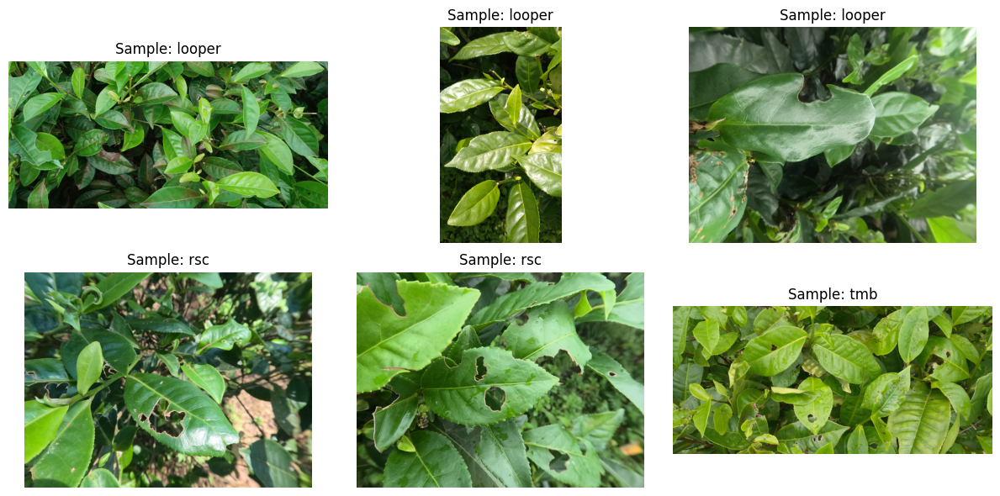

/home/idrone2/.local/lib/python3.11/site-packages/skimage/feature/texture.py:385: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


Feature matrix shape: (1200, 108)
Computing distance matrix...
Distance matrix shape: (1200, 1200)


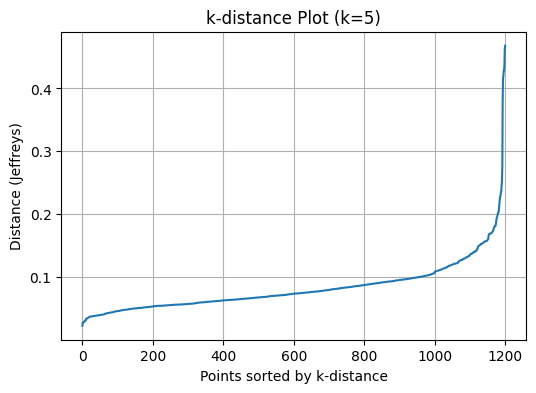

Knee found at eps ~ 0.1817
Selected eps: 0.1817
Cluster labels: [-1  0  1]


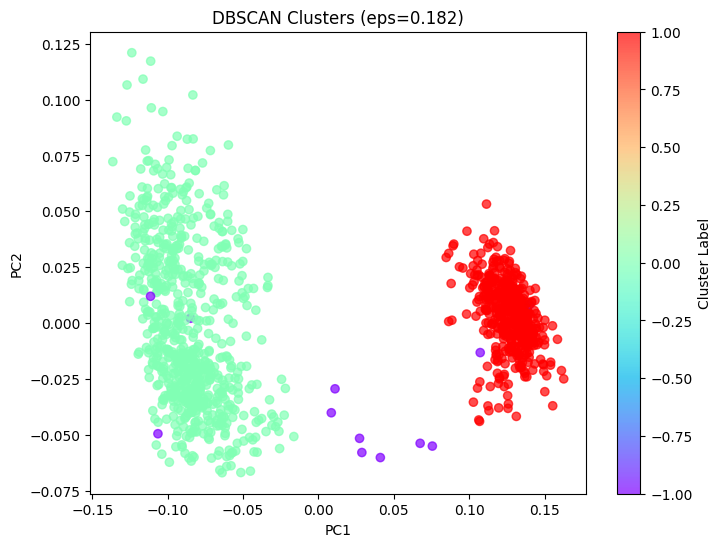

Outlier cluster (noise): 12 samples
Cluster 0: 708 samples
Cluster 1: 480 samples


In [2]:
import os
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt

# For local binary pattern (texture)
from skimage.feature import local_binary_pattern
from skimage.color import rgb2gray

# For elbow detection (optional)
try:
    from kneed import KneeLocator
    KNEED_AVAILABLE = True
except ImportError:
    KNEED_AVAILABLE = False
    print("Warning: 'kneed' not installed. Will fall back to percentile-based eps.")

from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

# ------------------ STEP 1: LOAD IMAGES ------------------ #

def load_images_from_folder(folder_path):
    """
    Loads all images in 'folder_path' and returns a list of image arrays in RGB.
    Basic error handling included.
    """
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist.")
        return []
    
    valid_exts = ('.png', '.jpg', '.jpeg', '.bmp')
    image_files = [f for f in os.listdir(folder_path)
                   if os.path.splitext(f)[1].lower() in valid_exts]
    
    if len(image_files) == 0:
        print(f"Warning: No valid images found in '{folder_path}'.")
        return []
    
    images = []
    for fname in image_files:
        fpath = os.path.join(folder_path, fname)
        try:
            img = cv2.imread(fpath)
            if img is None:
                print(f"Warning: Could not read '{fpath}'. Skipping.")
                continue
            # Convert BGR -> RGB
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            images.append(img_rgb)
        except Exception as e:
            print(f"Error reading '{fpath}': {e}")
    return images

# ------------------ STEP 2: FEATURE EXTRACTION ------------------ #

def extract_color_histogram(img, bins=32):
    """
    Extracts a 3-channel color histogram from the input image (RGB),
    each channel with 'bins' bins, concatenated into one vector.
    """
    # Normalize to [0,1]
    img_float = img.astype(np.float32) / 255.0
    
    # Hist per channel
    hist_r = cv2.calcHist([img_float], [0], None, [bins], [0,1]).flatten()
    hist_g = cv2.calcHist([img_float], [1], None, [bins], [0,1]).flatten()
    hist_b = cv2.calcHist([img_float], [2], None, [bins], [0,1]).flatten()
    
    # Combine
    color_hist = np.concatenate((hist_r, hist_g, hist_b))
    
    # Normalize so sum=1 (makes sense for Jeffreys Divergence)
    total = np.sum(color_hist) + 1e-7
    color_hist /= total
    return color_hist

def extract_texture_lbp(img, radius=1, n_points=8):
    """
    Extracts a local binary pattern (LBP) histogram from a grayscale image.
    """
    gray_img = rgb2gray(img)  # skimage color conversion
    lbp = local_binary_pattern(gray_img, n_points * radius, radius, method='uniform')
    
    # Build histogram of LBP
    max_bins = int(lbp.max() + 1)
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=max_bins, range=(0, max_bins))
    
    # Normalize
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-7)
    return lbp_hist

def detect_circles_and_compute_score(img):
    """
    Detect circles (possible lesions/spots) using Hough transform in grayscale.
    Returns a 'severity_score' based on the number of detected circles.
    """
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray = cv2.medianBlur(gray, 5)  # helps reduce noise
    
    # Tune these parameters for your dataset
    circles = cv2.HoughCircles(gray,
                               cv2.HOUGH_GRADIENT,
                               dp=1.2,
                               minDist=20,
                               param1=50,
                               param2=30,
                               minRadius=5,
                               maxRadius=60)
    
    severity_score = 0.0
    if circles is not None:
        circles = np.uint16(np.around(circles))
        severity_score = float(len(circles[0]))
    return severity_score

def extract_features(img, color_bins=32, lbp_radius=1, lbp_points=8):
    """
    Novel approach: Combine color histogram + LBP texture + circle-based severity
    into a single feature vector suitable for Jeffreys Divergence.
    
    Returns a 1D numpy array (concatenated).
    """
    # 1) Color histogram (normalized)
    color_hist = extract_color_histogram(img, bins=color_bins)
    
    # 2) LBP texture histogram (normalized)
    lbp_hist = extract_texture_lbp(img, radius=lbp_radius, n_points=lbp_points)
    
    # 3) Circle-based severity (scalar)
    severity_score = detect_circles_and_compute_score(img)
    
    # Convert severity to a mini distribution: [score/(1+score), 1/(1+score)]
    scaled_severity = severity_score / (1.0 + severity_score)
    severity_dist = np.array([scaled_severity, 1.0 - scaled_severity], dtype=np.float32)
    
    # Concatenate all features
    feature_vec = np.concatenate((color_hist, lbp_hist, severity_dist))
    return feature_vec

# ------------------ STEP 3: JEFFREYS DIVERGENCE ------------------ #

def jeffreys_divergence(p, q, eps=1e-10):
    """
    Jeffreys Divergence:
      D_J(p,q) = sum((p_i - q_i) * log(p_i / q_i)).
    We clip to avoid log(0).
    """
    p = np.clip(p, eps, None)
    q = np.clip(q, eps, None)
    return np.sum((p - q) * np.log(p / q))

# ------------------ STEP 4: BUILD PAIRWISE DISTANCE MATRIX ------------------ #

def compute_distance_matrix(features):
    """
    Given array of feature vectors (shape [N, dim]),
    compute NxN distance matrix using Jeffreys Divergence.
    """
    n = features.shape[0]
    dist_mat = np.zeros((n, n), dtype=np.float32)
    for i in range(n):
        for j in range(i+1, n):
            dist = jeffreys_divergence(features[i], features[j])
            dist_mat[i, j] = dist
            dist_mat[j, i] = dist
    return dist_mat

# ------------------ STEP 5: AUTO-SELECT EPS (k-DIST ELBOW) ------------------ #

def auto_select_eps_by_k_distance(dist_matrix, min_samples=5, plot=True):
    """
    Manually compute k-dist for each row, then find the 'elbow' using kneed
    or fallback to a percentile.
    """
    n = dist_matrix.shape[0]
    if n < min_samples:
        print("Not enough samples to estimate eps. Using default=0.5.")
        return 0.5
    
    k = min_samples
    k_distances = []
    for i in range(n):
        row = dist_matrix[i, :]
        # Remove self-distance
        row_no_self = np.delete(row, i)
        sorted_row = np.sort(row_no_self)
        if len(sorted_row) >= k:
            kth = sorted_row[k-1]
        else:
            kth = sorted_row[-1]
        k_distances.append(kth)
    
    k_distances = np.sort(k_distances)
    
    if plot:
        plt.figure(figsize=(6,4))
        plt.plot(k_distances)
        plt.title(f"k-distance Plot (k={k})")
        plt.xlabel("Points sorted by k-distance")
        plt.ylabel("Distance (Jeffreys)")
        plt.grid(True)
        plt.show()
    
    # Attempt knee detection with kneed if available
    if KNEED_AVAILABLE:
        try:
            kneedle = KneeLocator(
                x=range(len(k_distances)),
                y=k_distances,
                S=1.0,
                curve='convex',
                direction='increasing'
            )
            knee_val = kneedle.knee_y
            if knee_val is not None:
                print(f"Knee found at eps ~ {knee_val:.4f}")
                return knee_val
            else:
                print("No clear elbow found by kneed. Using 90th percentile fallback.")
        except Exception as e:
            print(f"Knee detection error: {e}. Using 90th percentile fallback.")
    
    fallback = np.percentile(k_distances, 90)
    print(f"Using fallback eps={fallback:.4f}")
    return fallback

# ------------------ STEP 6: MAIN PIPELINE ------------------ #

def main():
    """
    A complete research-oriented pipeline for infested leaf clustering:
    
    1) Load images from multiple subfolders.
    2) Extract features using a combination of color histogram, LBP texture, and Hough circle-based severity.
    3) Compute a pairwise distance matrix using Jeffreys Divergence.
    4) Automatically determine DBSCAN's eps using a k-distance elbow method.
    5) Run DBSCAN with the custom precomputed distance matrix.
    6) Visualize the clustering result using PCA and print cluster summaries.
    
    This novel approach combines multiple feature channels into a single normalized
    distribution, allowing Jeffreys Divergence to capture subtle differences in infestation patterns.
    """
    # Specify dataset path and subfolder names (update these paths as needed)
    dataset_path = "/home/idrone2/Desktop/sana"
    subfolders = ["looper", "rsc", "tmb"]
    
    # Load images from each subfolder
    all_images = []
    labels = []
    for sub in subfolders:
        folder = os.path.join(dataset_path, sub)
        imgs = load_images_from_folder(folder)
        all_images.extend(imgs)
        labels.extend([sub] * len(imgs))
    
    if len(all_images) == 0:
        print("No images loaded. Please check your dataset path and subfolder names.")
        return
    
    print(f"Total images loaded: {len(all_images)}")
    
    # Display a few sample images
    sample_count = min(6, len(all_images))
    plt.figure(figsize=(12, 6))
    for i, idx in enumerate(random.sample(range(len(all_images)), sample_count)):
        plt.subplot(2, 3, i+1)
        plt.imshow(all_images[idx])
        plt.title(f"Sample: {labels[idx]}")
        plt.axis("off")
    plt.tight_layout()
    plt.show()
    
    # Extract features for each image
    feature_list = []
    for img in all_images:
        feat = extract_features(img, color_bins=32, lbp_radius=1, lbp_points=8)
        if feat is not None:
            feature_list.append(feat)
    
    if len(feature_list) < 2:
        print("Not enough features extracted. Exiting.")
        return
    
    features = np.array(feature_list, dtype=np.float32)
    print("Feature matrix shape:", features.shape)
    
    # Compute pairwise distance matrix using Jeffreys Divergence
    print("Computing distance matrix...")
    distance_matrix = compute_distance_matrix(features)
    print("Distance matrix shape:", distance_matrix.shape)
    
    # Auto-select eps using k-distance elbow method
    min_samples = 5  # Adjust as needed
    eps = auto_select_eps_by_k_distance(distance_matrix, min_samples=min_samples, plot=True)
    print(f"Selected eps: {eps:.4f}")
    
    # Run DBSCAN with precomputed distance matrix
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric='precomputed')
    cluster_labels = dbscan.fit_predict(distance_matrix)
    unique_clusters = np.unique(cluster_labels)
    print("Cluster labels:", unique_clusters)
    
    # Visualize clustering using PCA (2D projection)
    pca = PCA(n_components=2)
    reduced_features = pca.fit_transform(features)
    
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(reduced_features[:, 0], reduced_features[:, 1],
                          c=cluster_labels, cmap="rainbow", alpha=0.7)
    plt.title(f"DBSCAN Clusters (eps={eps:.3f})")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    cbar = plt.colorbar(scatter)
    cbar.set_label("Cluster Label")
    plt.show()
    
    # Print summary of cluster sizes
    for cluster in unique_clusters:
        count = np.sum(cluster_labels == cluster)
        if cluster == -1:
            print(f"Outlier cluster (noise): {count} samples")
        else:
            print(f"Cluster {cluster}: {count} samples")

if __name__ == "__main__":
    main()


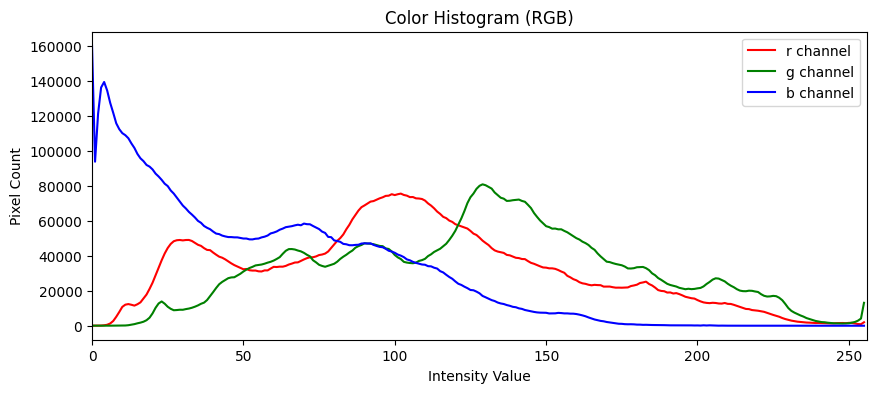

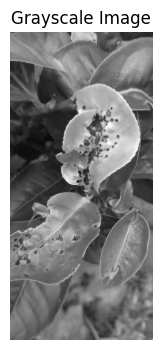

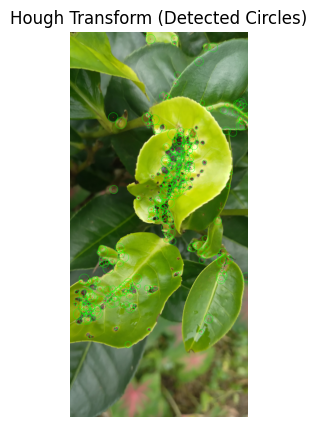

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def demo_color_histogram_grayscale_hough(image_path):
    # 1) LOAD IMAGE
    img_bgr = cv2.imread(image_path)
    if img_bgr is None:
        print(f"Error: Could not read '{image_path}'. Check the file path.")
        return
    
    # Convert BGR -> RGB for plotting with matplotlib
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    
    # 2) COLOR HISTOGRAM
    # We’ll compute a histogram for each channel: R, G, B
    plt.figure(figsize=(10, 4))
    colors = ('r', 'g', 'b')
    channel_ids = [0, 1, 2]  # R=0, G=1, B=2 in the img_rgb
    for (chan_id, c) in zip(channel_ids, colors):
        hist = cv2.calcHist([img_rgb], [chan_id], None, [256], [0, 256])
        plt.plot(hist, color=c, label=f'{c} channel')
    plt.title("Color Histogram (RGB)")
    plt.xlabel("Intensity Value")
    plt.ylabel("Pixel Count")
    plt.legend()
    plt.xlim([0, 256])
    plt.show()
    
    # 3) GRAYSCALE IMAGE
    img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)
    plt.figure(figsize=(5, 4))
    plt.imshow(img_gray, cmap='gray')
    plt.title("Grayscale Image")
    plt.axis('off')
    plt.show()
    
    # 4) HOUGH TRANSFORM (CIRCLES)
    # We'll blur the grayscale image to reduce noise, then detect circles.
    gray_blurred = cv2.medianBlur(img_gray, 5)
    
    # Apply HoughCircles
    circles = cv2.HoughCircles(
        gray_blurred,
        cv2.HOUGH_GRADIENT,   # detection method
        dp=1.2,               # inverse ratio of resolution
        minDist=30,           # minimum distance between circle centers
        param1=50,            # gradient value used in edge detection
        param2=30,            # accumulator threshold for circle detection
        minRadius=5,          # minimum circle radius
        maxRadius=60          # maximum circle radius
    )
    
    # Draw the detected circles on a copy of the original RGB image
    output_img = img_rgb.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for c in circles[0, :]:
            # center of circle
            center_x, center_y = c[0], c[1]
            radius = c[2]
            # draw the outer circle in green
            cv2.circle(output_img, (center_x, center_y), radius, (0, 255, 0), 2)
            # draw the center in red
            cv2.circle(output_img, (center_x, center_y), 2, (255, 0, 0), 3)
    
    # Show the result with detected circles
    plt.figure(figsize=(6, 5))
    plt.imshow(output_img)
    plt.title("Hough Transform (Detected Circles)")
    plt.axis('off')
    plt.show()

# Example usage:
if __name__ == "__main__":
    # Replace with the path to your leaf image or any other test image
    test_image_path = "/home/idrone2/Desktop/sana/tmb/20240806_105431.jpg"
    demo_color_histogram_grayscale_hough(test_image_path)


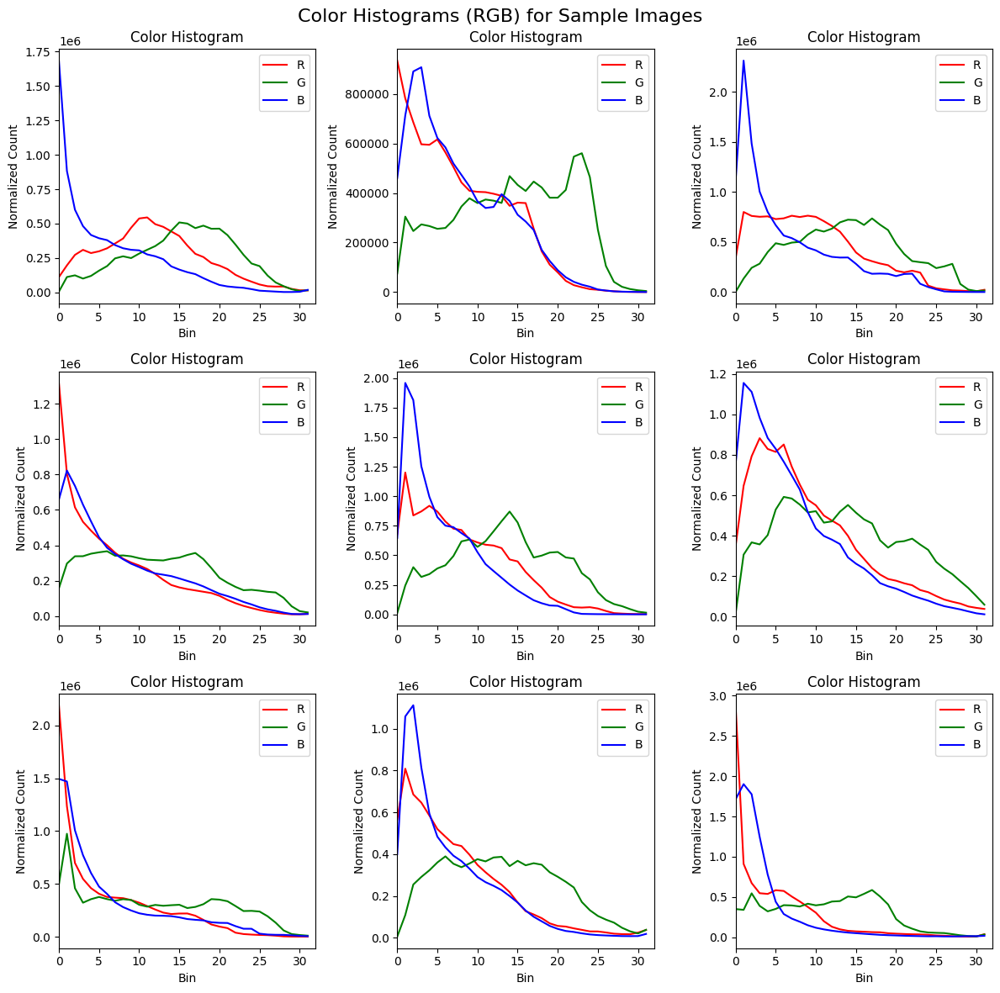

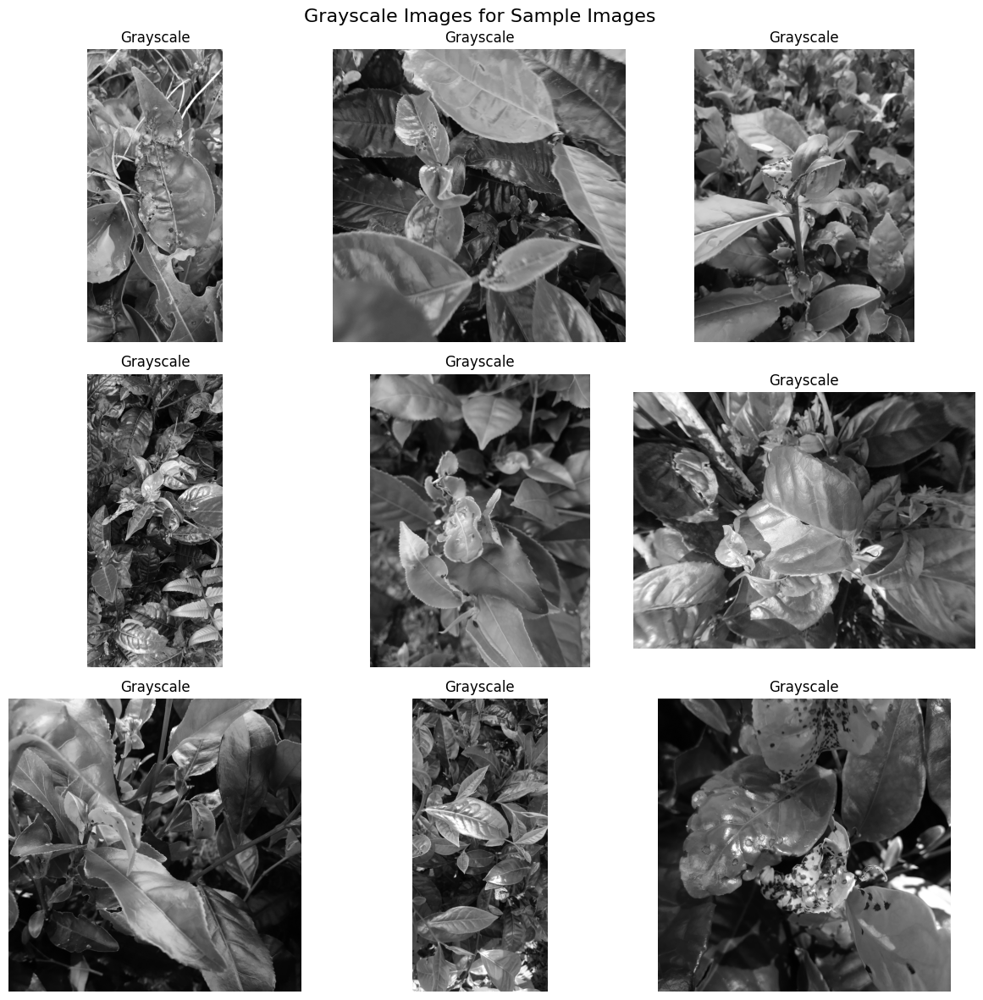

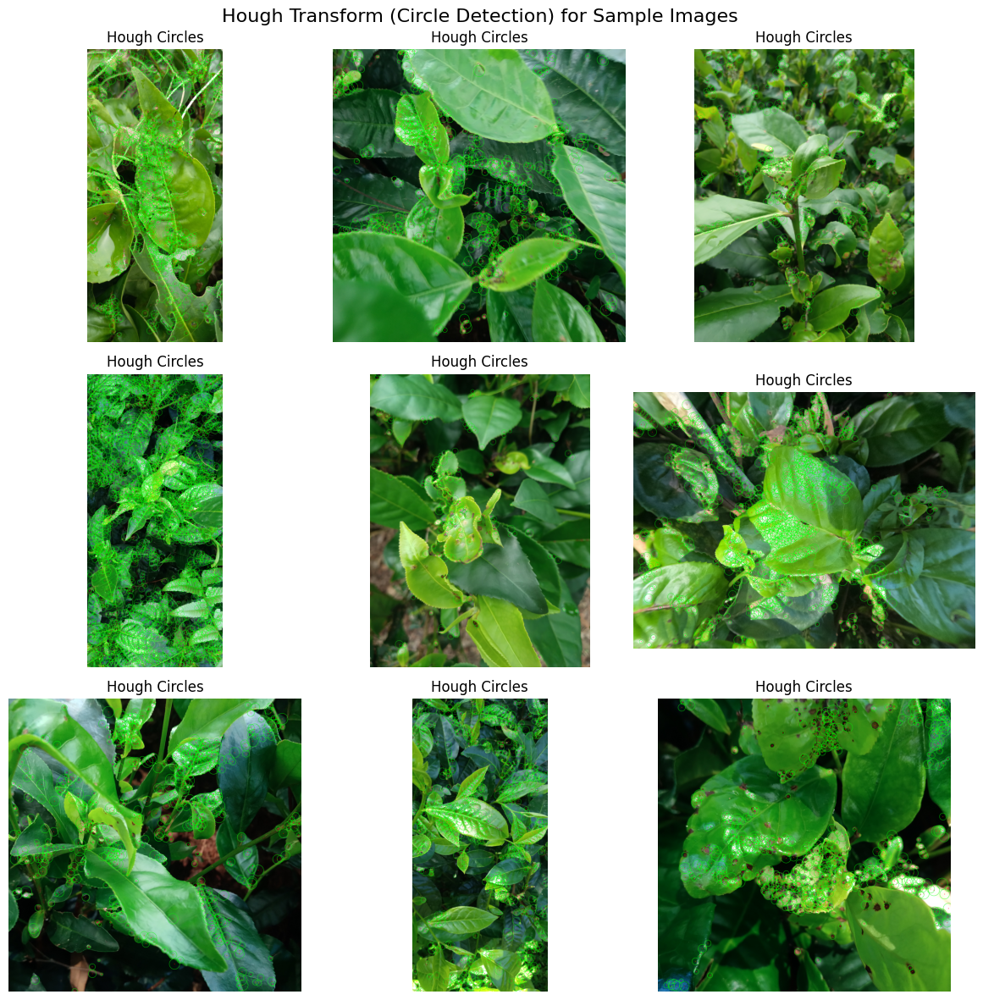

In [5]:
import os
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.color import rgb2gray

# For elbow detection (optional)
try:
    from kneed import KneeLocator
    KNEED_AVAILABLE = True
except ImportError:
    KNEED_AVAILABLE = False
    print("Warning: 'kneed' not installed. Will fall back to percentile-based eps.")

from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

# ------------------ Helper Functions ------------------ #

def load_images_from_folder(folder_path):
    """
    Loads all images in 'folder_path' and returns a list of image arrays in RGB.
    Basic error handling included.
    """
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist.")
        return []
    
    valid_exts = ('.png', '.jpg', '.jpeg', '.bmp')
    image_files = [f for f in os.listdir(folder_path)
                   if os.path.splitext(f)[1].lower() in valid_exts]
    
    if len(image_files) == 0:
        print(f"Warning: No valid images found in '{folder_path}'.")
        return []
    
    images = []
    for fname in image_files:
        fpath = os.path.join(folder_path, fname)
        try:
            img = cv2.imread(fpath)
            if img is None:
                print(f"Warning: Could not read '{fpath}'. Skipping.")
                continue
            # Convert BGR -> RGB
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            images.append(img_rgb)
        except Exception as e:
            print(f"Error reading '{fpath}': {e}")
    return images

def extract_color_histogram(img, bins=32):
    """
    Extracts a 3-channel color histogram from the input image (RGB),
    each channel with 'bins' bins, concatenated into one vector.
    Returns the histogram and also a figure (if needed) for plotting.
    """
    # Normalize to [0,1]
    img_float = img.astype(np.float32) / 255.0
    # Compute histogram for each channel
    hist_r = cv2.calcHist([img_float], [0], None, [bins], [0, 1]).flatten()
    hist_g = cv2.calcHist([img_float], [1], None, [bins], [0, 1]).flatten()
    hist_b = cv2.calcHist([img_float], [2], None, [bins], [0, 1]).flatten()
    # Combine and normalize so sum = 1
    color_hist = np.concatenate((hist_r, hist_g, hist_b))
    total = np.sum(color_hist) + 1e-7
    color_hist /= total
    return color_hist

def plot_color_histogram(ax, img, bins=32):
    """
    Plots the color histogram of an image on the provided axis.
    """
    img_float = img.astype(np.float32) / 255.0
    colors = ('r', 'g', 'b')
    channel_ids = [0, 1, 2]
    for (chan, c) in zip(channel_ids, colors):
        hist = cv2.calcHist([img_float], [chan], None, [bins], [0, 1]).flatten()
        ax.plot(hist, color=c, label=f'{c.upper()}')
    ax.set_title("Color Histogram")
    ax.set_xlabel("Bin")
    ax.set_ylabel("Normalized Count")
    ax.legend()
    ax.set_xlim([0, bins])

def get_grayscale_image(img):
    """
    Returns the grayscale version of the image.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    return img_gray

def get_hough_transform_image(img):
    """
    Applies Hough Circle Transform to detect circles and overlays the detected circles 
    on a copy of the original image.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_blurred = cv2.medianBlur(img_gray, 5)
    circles = cv2.HoughCircles(gray_blurred,
                               cv2.HOUGH_GRADIENT,
                               dp=1.2,
                               minDist=30,
                               param1=50,
                               param2=30,
                               minRadius=5,
                               maxRadius=60)
    output_img = img.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for c in circles[0, :]:
            center = (c[0], c[1])
            radius = c[2]
            cv2.circle(output_img, center, radius, (0, 255, 0), 2)
            cv2.circle(output_img, center, 2, (255, 0, 0), 3)
    return output_img

# ------------------ Main Processing and Visualization ------------------ #

def process_and_display(image_folder, sample_size=9, bins=32):
    """
    Processes images from the given folder, randomly samples 'sample_size' images,
    and displays three figures in a 3x3 grid:
      - Color Histograms
      - Grayscale Images
      - Hough Transform Results
    """
    # Load images
    images = load_images_from_folder(image_folder)
    if len(images) == 0:
        print("No images found. Exiting.")
        return

    # Randomly select 'sample_size' images
    sample_images = random.sample(images, min(sample_size, len(images)))
    
    # ---------------- Figure 1: Color Histograms ---------------- #
    fig1, axes1 = plt.subplots(3, 3, figsize=(12, 12))
    axes1 = axes1.flatten()
    for ax, img in zip(axes1, sample_images):
        plot_color_histogram(ax, img, bins=bins)
    fig1.suptitle("Color Histograms (RGB) for Sample Images", fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # ---------------- Figure 2: Grayscale Images ---------------- #
    fig2, axes2 = plt.subplots(3, 3, figsize=(12, 12))
    axes2 = axes2.flatten()
    for ax, img in zip(axes2, sample_images):
        img_gray = get_grayscale_image(img)
        ax.imshow(img_gray, cmap='gray')
        ax.set_title("Grayscale")
        ax.axis("off")
    fig2.suptitle("Grayscale Images for Sample Images", fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # ---------------- Figure 3: Hough Transform Results ---------------- #
    fig3, axes3 = plt.subplots(3, 3, figsize=(12, 12))
    axes3 = axes3.flatten()
    for ax, img in zip(axes3, sample_images):
        hough_img = get_hough_transform_image(img)
        ax.imshow(hough_img)
        ax.set_title("Hough Circles")
        ax.axis("off")
    fig3.suptitle("Hough Transform (Circle Detection) for Sample Images", fontsize=16)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    # Replace with your actual dataset folder path
    dataset_folder = "/home/idrone2/Desktop/sana/tmb"
    process_and_display(dataset_folder, sample_size=9, bins=32)



Processing subfolder: /home/idrone2/Desktop/sana/rsc


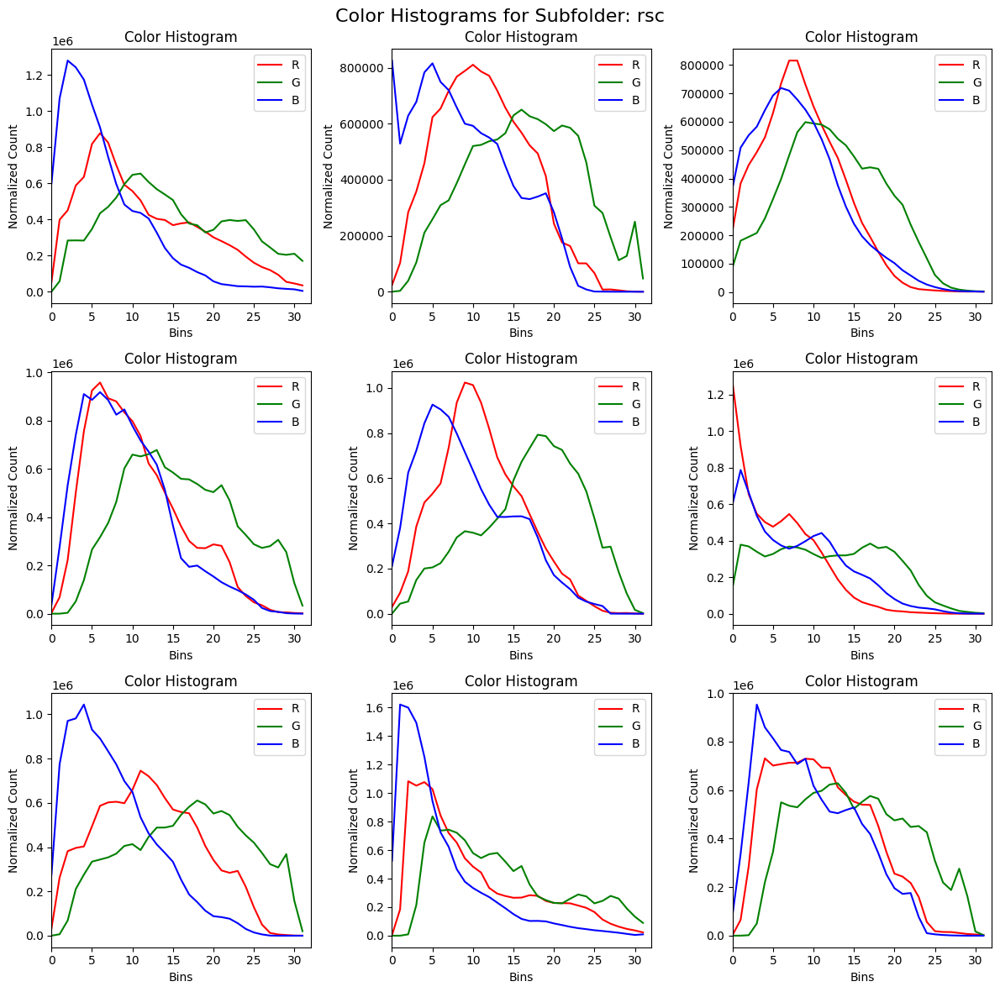

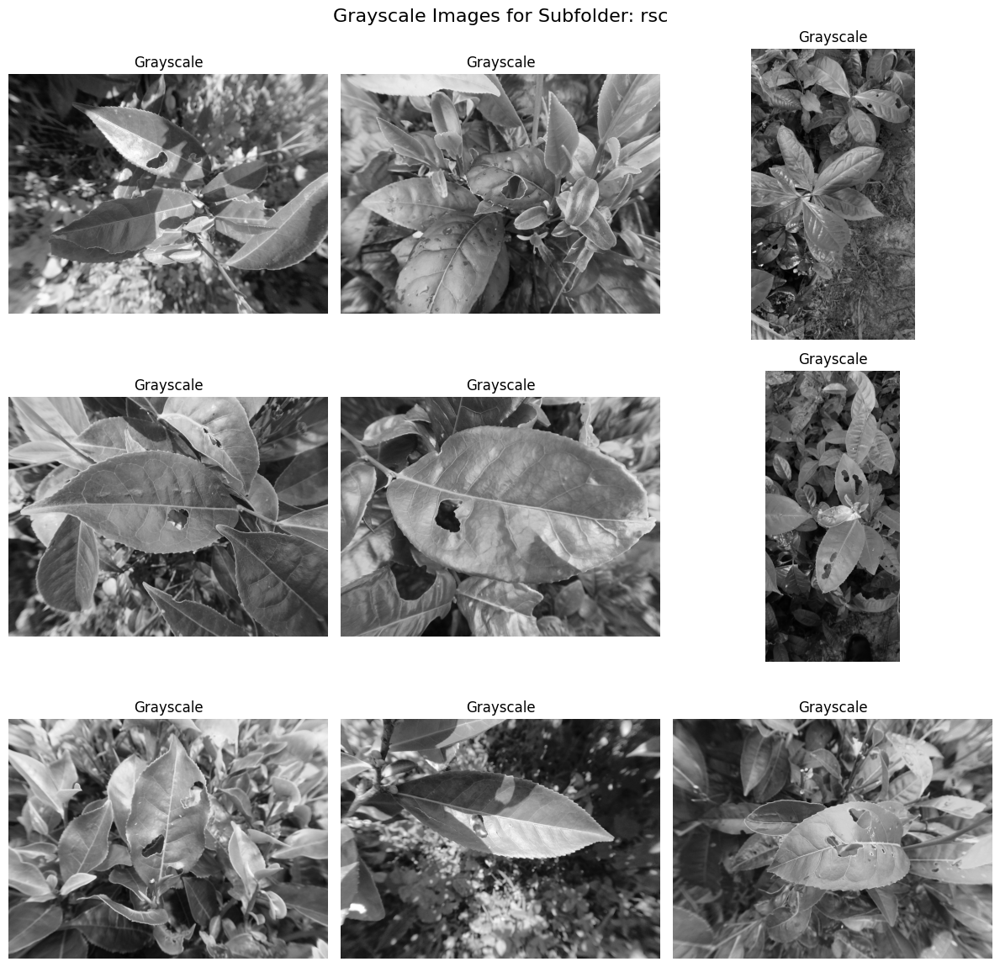

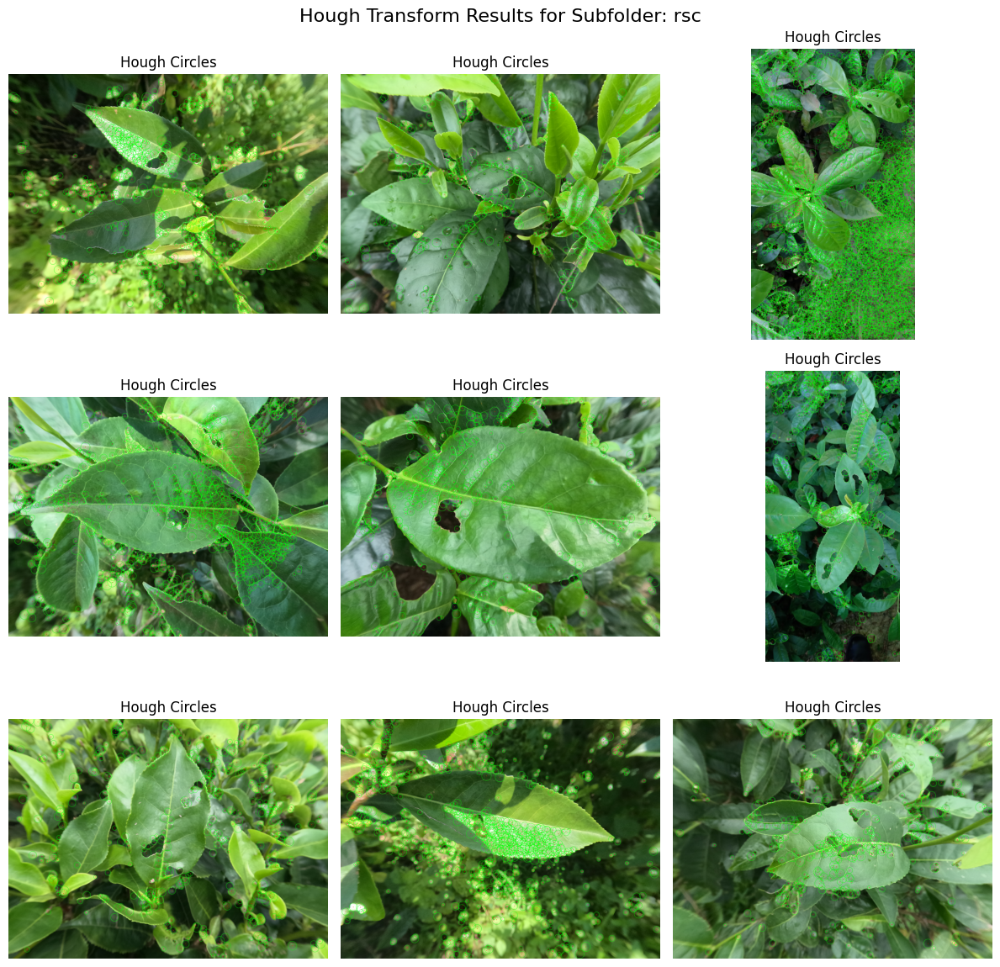


Processing subfolder: /home/idrone2/Desktop/sana/looper


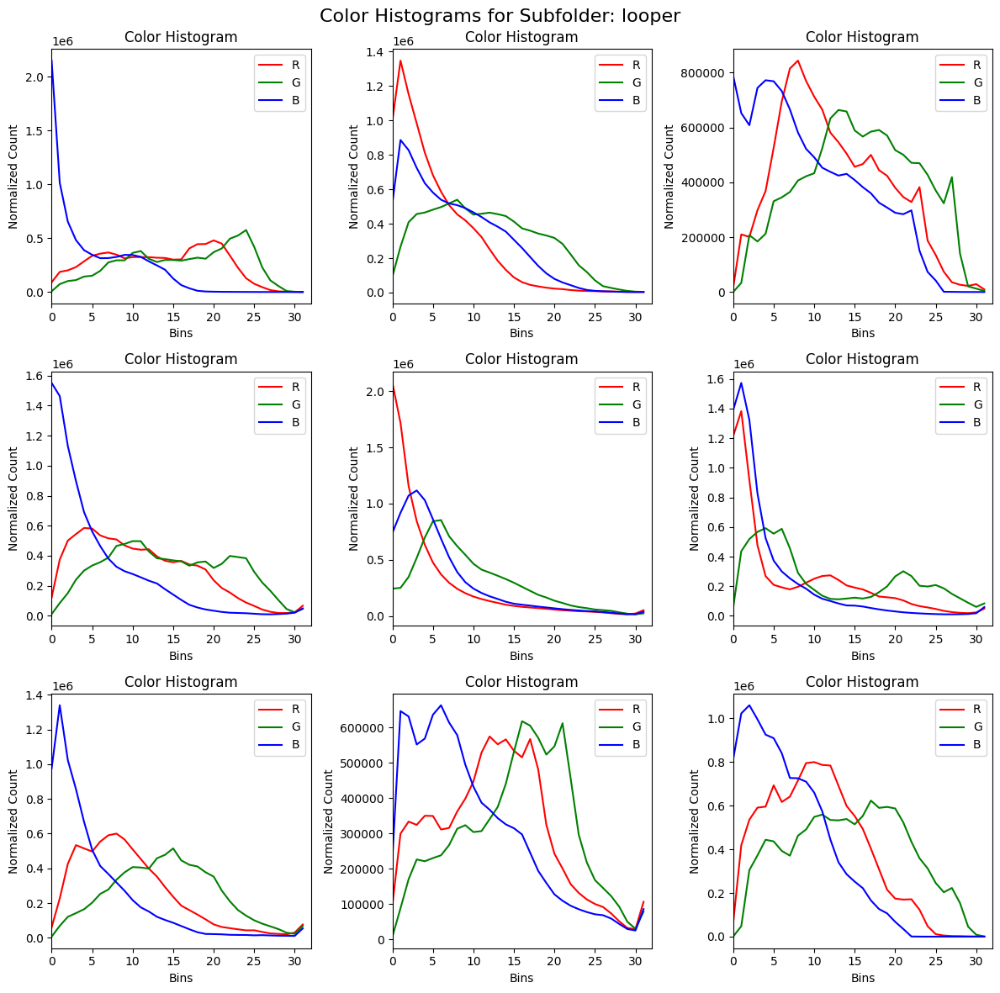

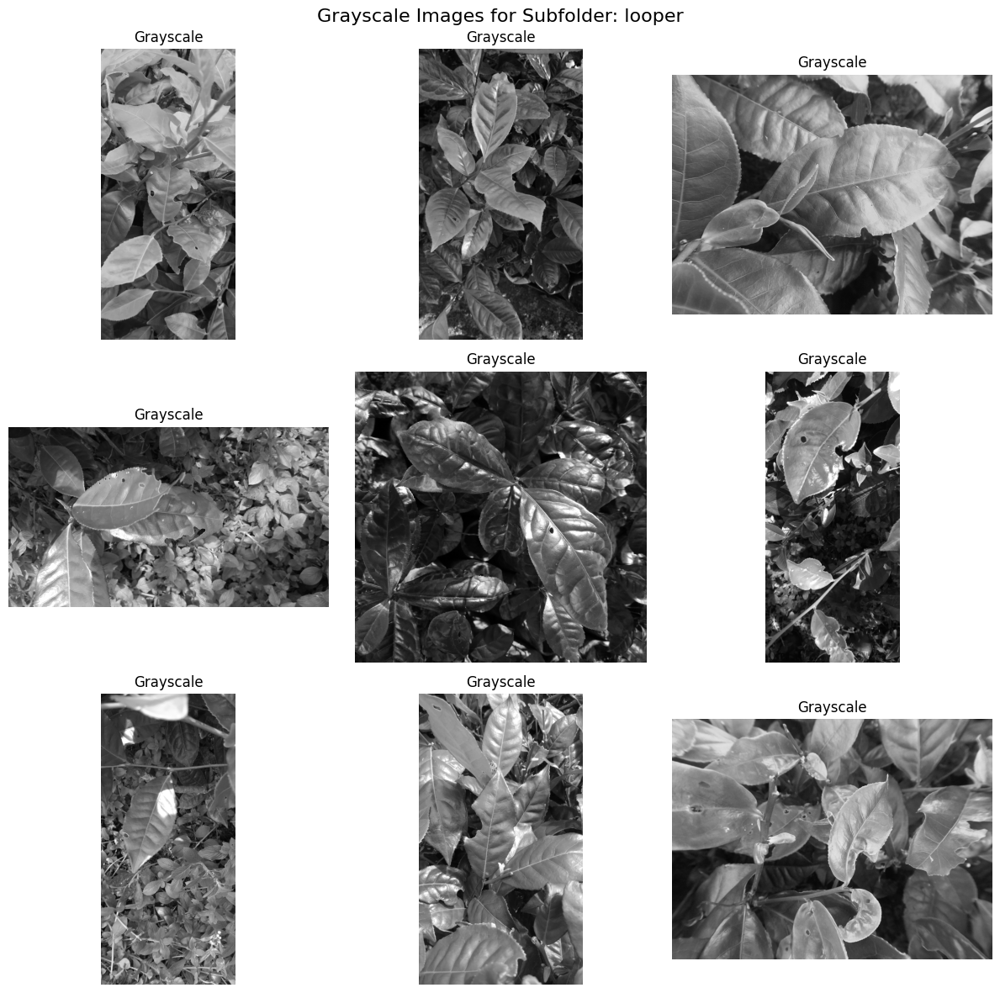

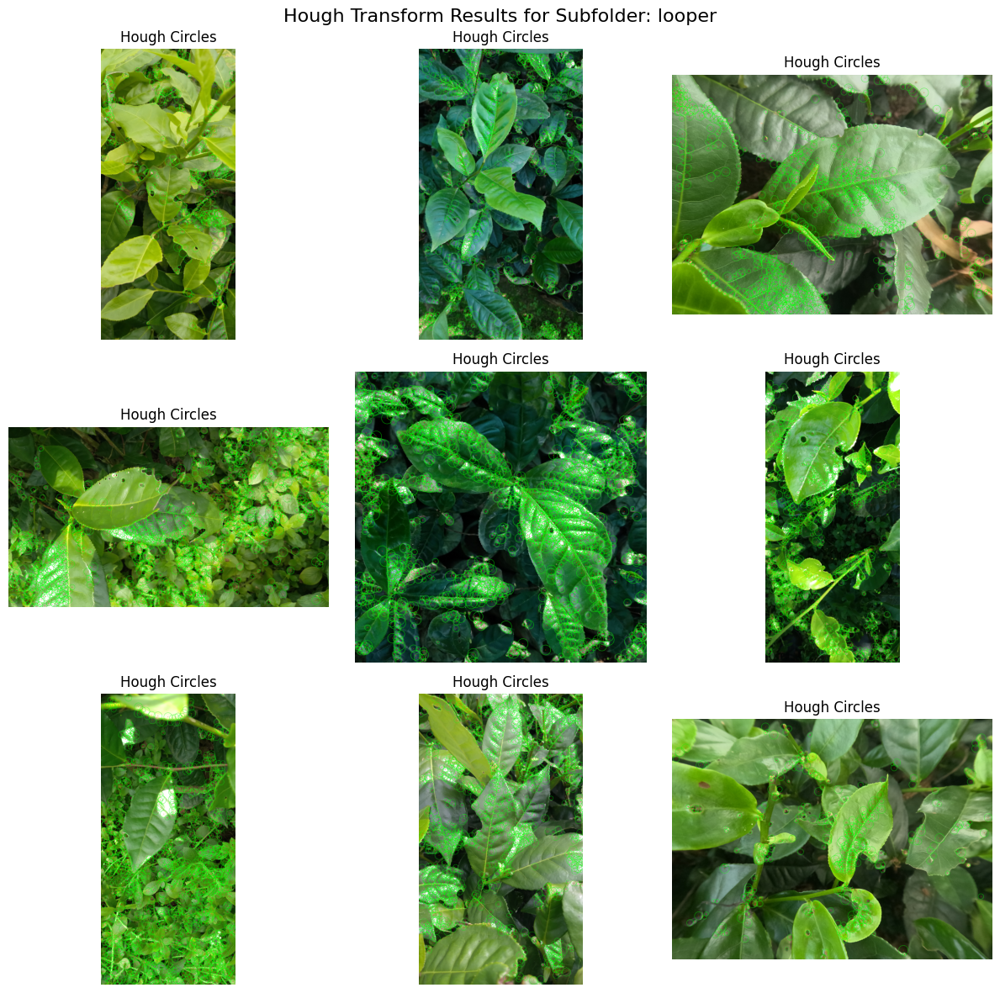


Processing subfolder: /home/idrone2/Desktop/sana/tmb


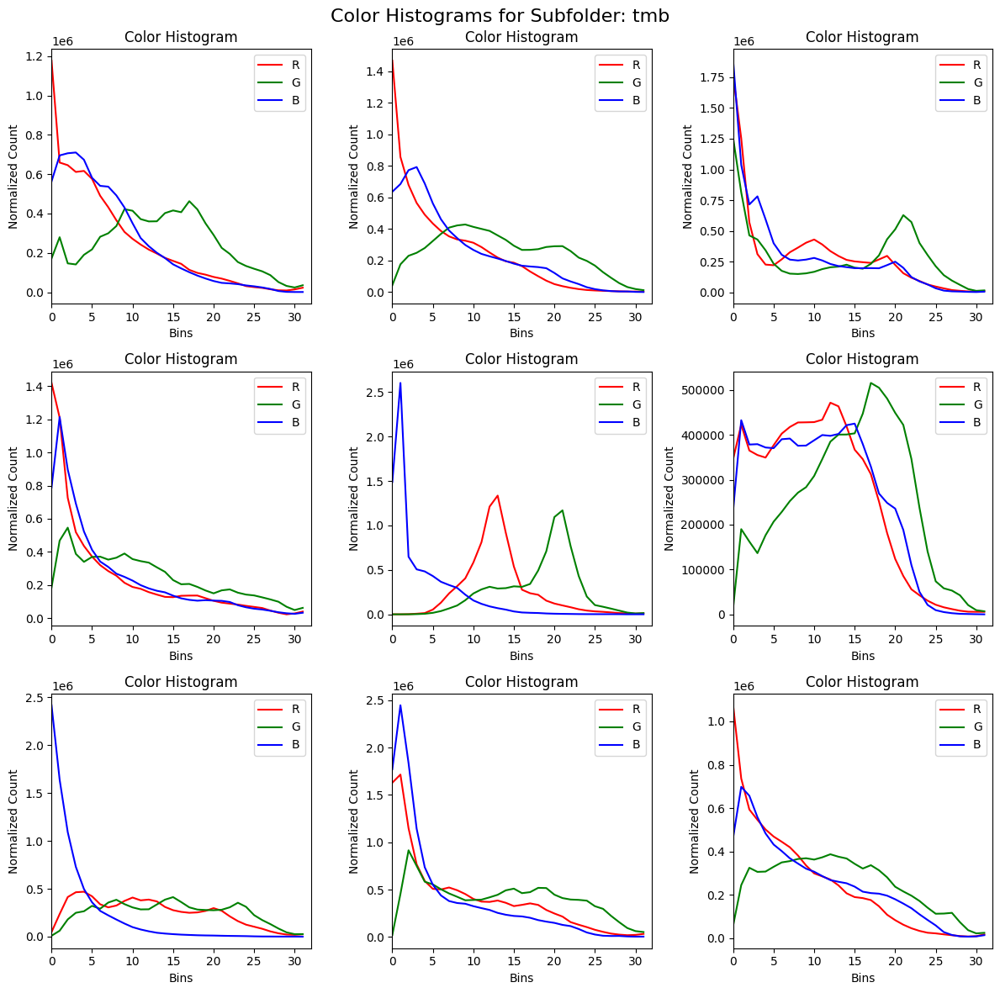

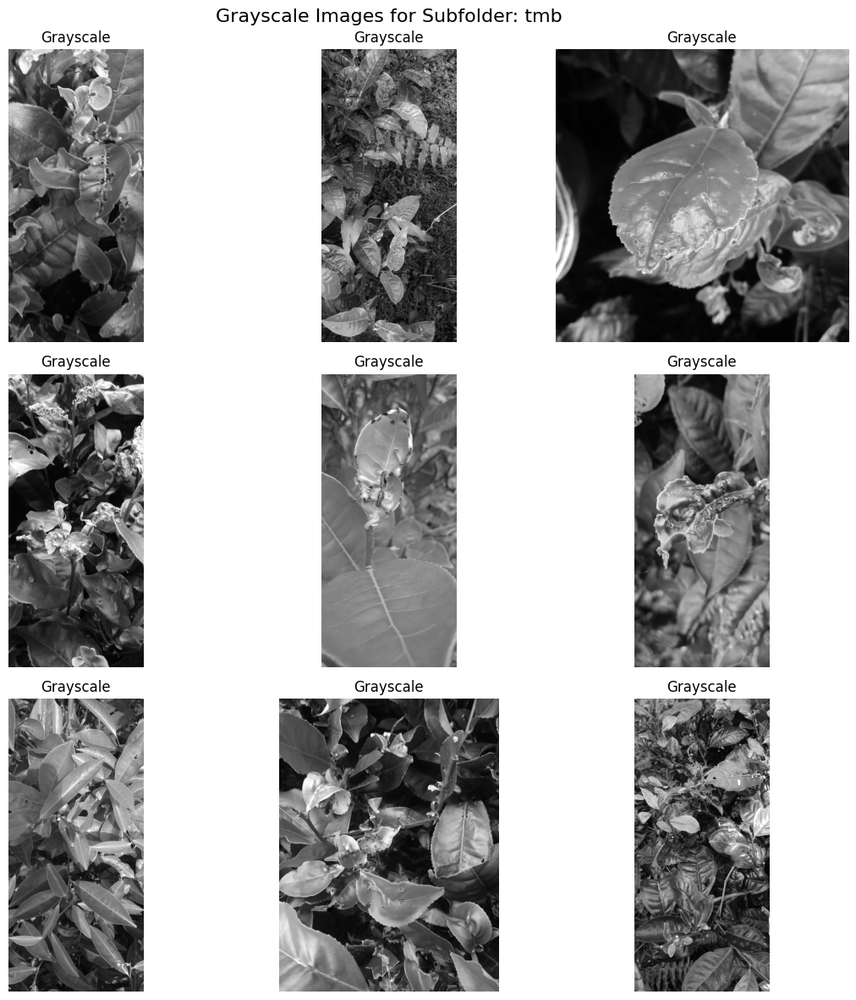

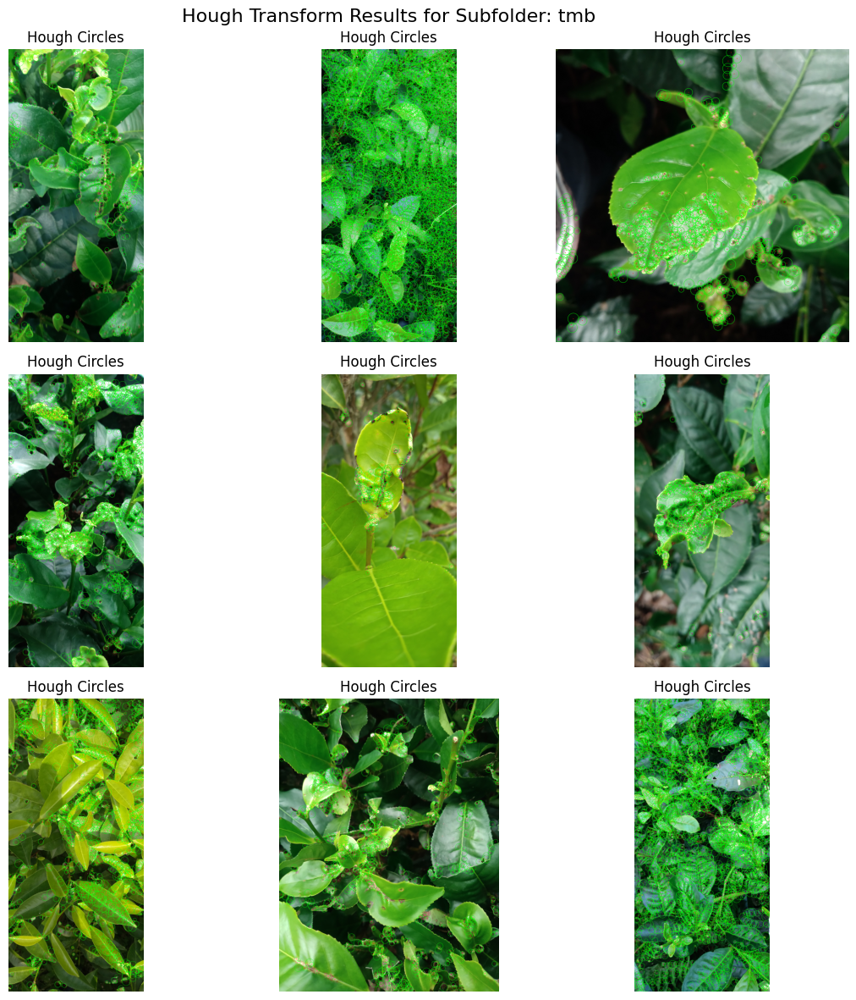

In [6]:
import os
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.color import rgb2gray

# For elbow detection (optional)
try:
    from kneed import KneeLocator
    KNEED_AVAILABLE = True
except ImportError:
    KNEED_AVAILABLE = False
    print("Warning: 'kneed' not installed. Will fall back to percentile-based eps.")

from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

# ------------------ Helper Functions ------------------ #

def load_images_from_folder(folder_path):
    """
    Loads all images in 'folder_path' and returns a list of image arrays in RGB.
    Basic error handling included.
    """
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist.")
        return []
    
    valid_exts = ('.png', '.jpg', '.jpeg', '.bmp')
    image_files = [f for f in os.listdir(folder_path)
                   if os.path.splitext(f)[1].lower() in valid_exts]
    
    if len(image_files) == 0:
        print(f"Warning: No valid images found in '{folder_path}'.")
        return []
    
    images = []
    for fname in image_files:
        fpath = os.path.join(folder_path, fname)
        try:
            img = cv2.imread(fpath)
            if img is None:
                print(f"Warning: Could not read '{fpath}'. Skipping.")
                continue
            # Convert from BGR to RGB
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            images.append(img_rgb)
        except Exception as e:
            print(f"Error reading '{fpath}': {e}")
    return images

def plot_color_histogram(ax, img, bins=32):
    """
    Plots the color histogram of an image on the given axis.
    """
    img_float = img.astype(np.float32) / 255.0
    colors = ('r', 'g', 'b')
    channel_ids = [0, 1, 2]
    for (chan, c) in zip(channel_ids, colors):
        hist = cv2.calcHist([img_float], [chan], None, [bins], [0, 1]).flatten()
        ax.plot(hist, color=c, label=f'{c.upper()}')
    ax.set_title("Color Histogram")
    ax.set_xlabel("Bins")
    ax.set_ylabel("Normalized Count")
    ax.legend()
    ax.set_xlim([0, bins])

def get_grayscale_image(img):
    """
    Returns the grayscale version of the given RGB image.
    """
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def get_hough_transform_image(img):
    """
    Applies Hough Circle Transform on the image and returns a copy with detected circles overlaid.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_blurred = cv2.medianBlur(img_gray, 5)
    circles = cv2.HoughCircles(
        gray_blurred,
        cv2.HOUGH_GRADIENT,
        dp=1.2,
        minDist=30,
        param1=50,
        param2=30,
        minRadius=5,
        maxRadius=60
    )
    output_img = img.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for c in circles[0, :]:
            center = (c[0], c[1])
            radius = c[2]
            cv2.circle(output_img, center, radius, (0, 255, 0), 2)
            cv2.circle(output_img, center, 2, (255, 0, 0), 3)
    return output_img

def process_and_display(subfolder_path, sample_size=9, bins=32):
    """
    Processes images from the given subfolder and displays three figures:
      - 3x3 grid of color histograms.
      - 3x3 grid of grayscale images.
      - 3x3 grid of Hough transform results.
    """
    images = load_images_from_folder(subfolder_path)
    if not images:
        print(f"No images found in {subfolder_path}.")
        return
    
    # Sample images randomly from the subfolder (up to sample_size)
    sample_images = random.sample(images, min(sample_size, len(images)))
    
    # Figure 1: Color Histograms
    fig1, axes1 = plt.subplots(3, 3, figsize=(12, 12))
    axes1 = axes1.flatten()
    for ax, img in zip(axes1, sample_images):
        plot_color_histogram(ax, img, bins=bins)
    fig1.suptitle(f"Color Histograms for Subfolder: {os.path.basename(subfolder_path)}", fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # Figure 2: Grayscale Images
    fig2, axes2 = plt.subplots(3, 3, figsize=(12, 12))
    axes2 = axes2.flatten()
    for ax, img in zip(axes2, sample_images):
        img_gray = get_grayscale_image(img)
        ax.imshow(img_gray, cmap='gray')
        ax.set_title("Grayscale")
        ax.axis("off")
    fig2.suptitle(f"Grayscale Images for Subfolder: {os.path.basename(subfolder_path)}", fontsize=16)
    plt.tight_layout()
    plt.show()
    
    # Figure 3: Hough Transform Results
    fig3, axes3 = plt.subplots(3, 3, figsize=(12, 12))
    axes3 = axes3.flatten()
    for ax, img in zip(axes3, sample_images):
        hough_img = get_hough_transform_image(img)
        ax.imshow(hough_img)
        ax.set_title("Hough Circles")
        ax.axis("off")
    fig3.suptitle(f"Hough Transform Results for Subfolder: {os.path.basename(subfolder_path)}", fontsize=16)
    plt.tight_layout()
    plt.show()

def process_dataset(parent_folder, sample_size=9, bins=32):
    """
    Iterates over subfolders in the parent folder and processes each one.
    """
    if not os.path.isdir(parent_folder):
        print(f"Error: Parent folder '{parent_folder}' does not exist.")
        return
    
    # List subfolders in the parent folder
    subfolders = [os.path.join(parent_folder, d) for d in os.listdir(parent_folder)
                  if os.path.isdir(os.path.join(parent_folder, d))]
    
    if not subfolders:
        print("No subfolders found in the parent folder.")
        return
    
    for subfolder in subfolders:
        print(f"\nProcessing subfolder: {subfolder}")
        process_and_display(subfolder, sample_size=sample_size, bins=bins)

if __name__ == "__main__":
    # Replace with the path to your parent folder that contains 3 subfolders
    parent_dataset_folder = "/home/idrone2/Desktop/sana"
    process_dataset(parent_dataset_folder, sample_size=9, bins=32)


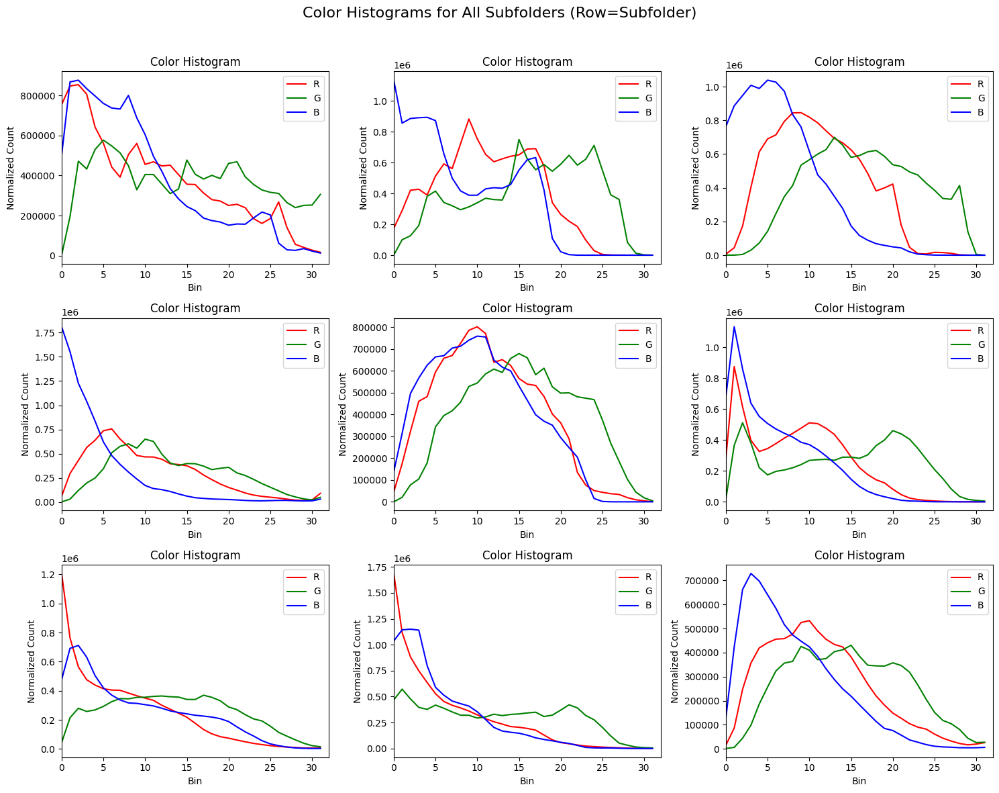

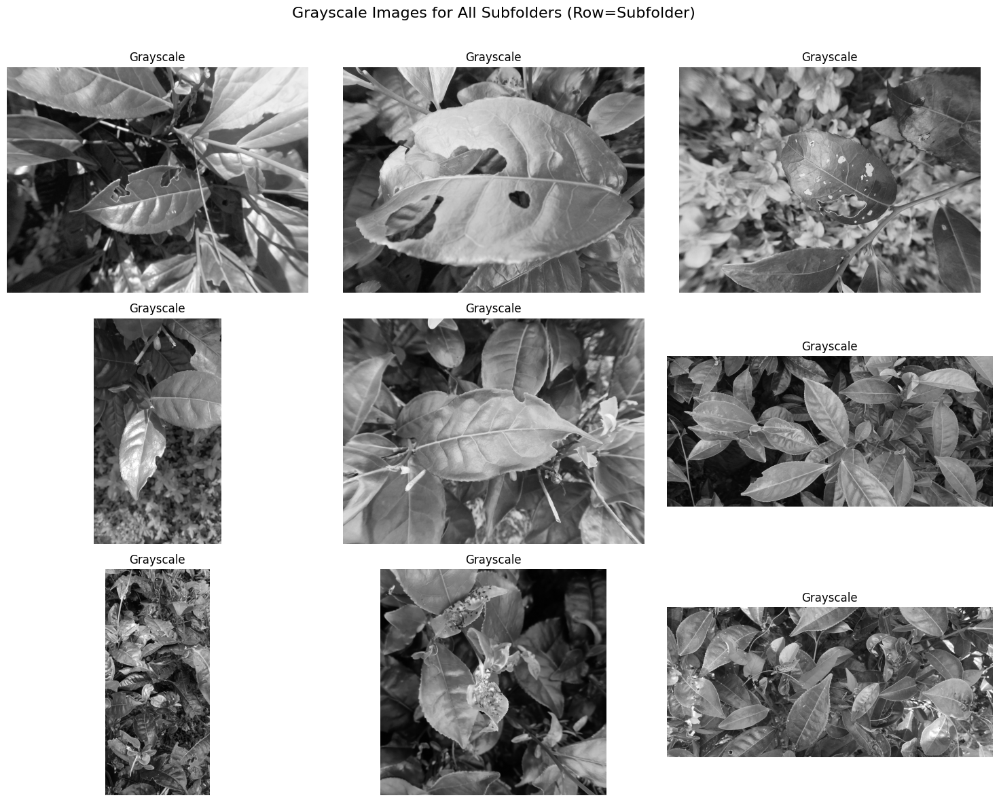

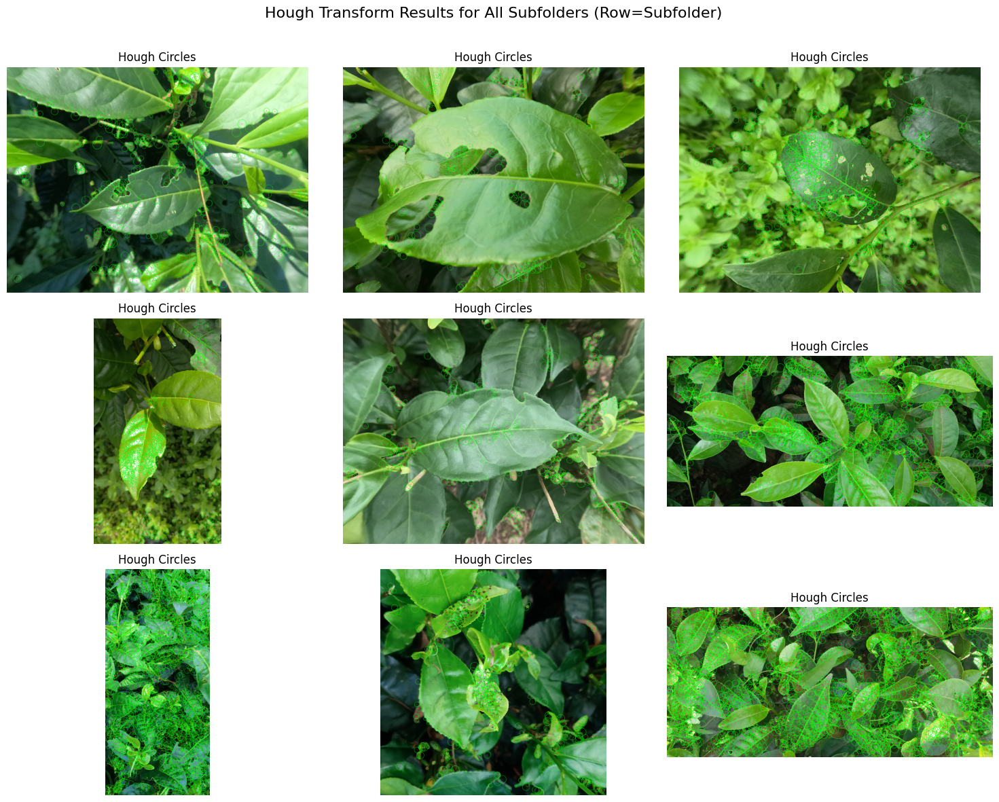

In [8]:
import os
import random
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from skimage.color import rgb2gray

# For elbow detection (optional)
try:
    from kneed import KneeLocator
    KNEED_AVAILABLE = True
except ImportError:
    KNEED_AVAILABLE = False
    print("Warning: 'kneed' not installed. Will fall back to percentile-based eps.")

from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

# ------------------ Helper Functions ------------------ #

def load_images_from_folder(folder_path):
    """
    Loads all images in 'folder_path' and returns a list of image arrays in RGB.
    """
    if not os.path.isdir(folder_path):
        print(f"Error: Folder '{folder_path}' does not exist.")
        return []
    
    valid_exts = ('.png', '.jpg', '.jpeg', '.bmp')
    image_files = [f for f in os.listdir(folder_path)
                   if os.path.splitext(f)[1].lower() in valid_exts]
    
    if len(image_files) == 0:
        print(f"Warning: No valid images found in '{folder_path}'.")
        return []
    
    images = []
    for fname in image_files:
        fpath = os.path.join(folder_path, fname)
        try:
            img = cv2.imread(fpath)
            if img is None:
                print(f"Warning: Could not read '{fpath}'. Skipping.")
                continue
            img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            images.append(img_rgb)
        except Exception as e:
            print(f"Error reading '{fpath}': {e}")
    return images

def plot_color_histogram(ax, img, bins=32):
    """
    Plots the color histogram (R, G, B) for a given image on the provided axis.
    """
    img_float = img.astype(np.float32) / 255.0
    colors = ('r', 'g', 'b')
    channel_ids = [0, 1, 2]
    for (chan, c) in zip(channel_ids, colors):
        hist = cv2.calcHist([img_float], [chan], None, [bins], [0, 1]).flatten()
        ax.plot(hist, color=c, label=f'{c.upper()}')
    ax.set_title("Color Histogram")
    ax.set_xlabel("Bin")
    ax.set_ylabel("Normalized Count")
    ax.legend()
    ax.set_xlim([0, bins])

def get_grayscale_image(img):
    """
    Returns the grayscale version of the given RGB image.
    """
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

def get_hough_transform_image(img):
    """
    Applies Hough Circle Transform to detect circles in the image and
    returns a copy of the original image with detected circles overlaid.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    gray_blurred = cv2.medianBlur(img_gray, 5)
    circles = cv2.HoughCircles(gray_blurred,
                               cv2.HOUGH_GRADIENT,
                               dp=1.2,
                               minDist=30,
                               param1=50,
                               param2=30,
                               minRadius=5,
                               maxRadius=60)
    output_img = img.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for c in circles[0, :]:
            center = (c[0], c[1])
            radius = c[2]
            cv2.circle(output_img, center, radius, (0, 255, 0), 2)
            cv2.circle(output_img, center, 2, (255, 0, 0), 3)
    return output_img

# ------------------ Main Grid Processing Function ------------------ #

def process_dataset_grid(parent_folder, images_per_subfolder=3, bins=32):
    """
    Assumes parent_folder contains exactly 3 subfolders.
    For each subfolder, randomly selects images_per_subfolder images.
    Then, for each visualization type (color histogram, grayscale, Hough transform),
    displays a single figure arranged as a 3x3 grid where:
      - Row 1: images from subfolder 1
      - Row 2: images from subfolder 2
      - Row 3: images from subfolder 3
    """
    if not os.path.isdir(parent_folder):
        print(f"Error: Parent folder '{parent_folder}' does not exist.")
        return

    # List subfolders (if more than 3, use the first 3)
    subfolders = [os.path.join(parent_folder, d) for d in os.listdir(parent_folder)
                  if os.path.isdir(os.path.join(parent_folder, d))]
    if len(subfolders) < 3:
        print("Error: Expected at least 3 subfolders in the parent folder.")
        return
    subfolders = subfolders[:3]

    # For each subfolder, randomly sample images_per_subfolder images
    samples = []  # List of lists; one list per subfolder
    for folder in subfolders:
        imgs = load_images_from_folder(folder)
        if len(imgs) < images_per_subfolder:
            print(f"Warning: Subfolder {folder} has less than {images_per_subfolder} images.")
        sample_imgs = random.sample(imgs, min(images_per_subfolder, len(imgs)))
        samples.append(sample_imgs)

    # ------------------ Figure 1: Color Histograms ------------------ #
    fig1, axes1 = plt.subplots(3, images_per_subfolder, figsize=(15, 12))
    for row in range(3):
        for col in range(images_per_subfolder):
            ax = axes1[row, col]
            # Ensure we have an image; if not, clear the axis
            if col < len(samples[row]):
                plot_color_histogram(ax, samples[row][col], bins=bins)
            else:
                ax.axis('off')
    fig1.suptitle("Color Histograms for All Subfolders (Row=Subfolder)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    # ------------------ Figure 2: Grayscale Images ------------------ #
    fig2, axes2 = plt.subplots(3, images_per_subfolder, figsize=(15, 12))
    for row in range(3):
        for col in range(images_per_subfolder):
            ax = axes2[row, col]
            if col < len(samples[row]):
                img_gray = get_grayscale_image(samples[row][col])
                ax.imshow(img_gray, cmap='gray')
                ax.set_title("Grayscale")
                ax.axis("off")
            else:
                ax.axis("off")
    fig2.suptitle("Grayscale Images for All Subfolders (Row=Subfolder)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

    # ------------------ Figure 3: Hough Transform Results ------------------ #
    fig3, axes3 = plt.subplots(3, images_per_subfolder, figsize=(15, 12))
    for row in range(3):
        for col in range(images_per_subfolder):
            ax = axes3[row, col]
            if col < len(samples[row]):
                hough_img = get_hough_transform_image(samples[row][col])
                ax.imshow(hough_img)
                ax.set_title("Hough Circles")
                ax.axis("off")
            else:
                ax.axis("off")
    fig3.suptitle("Hough Transform Results for All Subfolders (Row=Subfolder)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

if __name__ == "__main__":
    # Replace with the path to your parent folder containing 3 subfolders
    parent_dataset_folder = "/home/idrone2/Desktop/sana"
    process_dataset_grid(parent_dataset_folder, images_per_subfolder=3, bins=32)
